<a href="https://colab.research.google.com/github/georgezefko/car-part-segmentation/blob/main/GAN_Deconvolution.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [2]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import glob
import cv2
import numpy
from numpy import cov
from numpy import trace
from numpy import iscomplexobj
from numpy import asarray
from numpy.random import shuffle
from scipy.linalg import sqrtm
from keras.applications.inception_v3 import InceptionV3
from keras.applications.inception_v3 import preprocess_input
from skimage.transform import resize

In [3]:
# Set random seem for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)


Random Seed:  999


In [4]:
all_images_path = '/content/drive/MyDrive/final_set/signle_colors'
all_car_names = [img for img in glob.glob(all_images_path + "/*.jpg")]
all_car_names.sort() # ADD THIS LINE
all_cars = []
for img in all_car_names:
    n= cv2.imread(img)
    all_cars.append(n)
img =  np.array(all_cars)  

In [7]:
#this fucntion preprocess fake imags
def fake_pre_process(fake):
  fi = fake
  f2 = fi.permute(0,2,3,1)
  f2 = f2*255
  f2 = f2.detach().cpu()
  f2 = np.array(f2)
  f2 = f2.astype(np.uint8)
  f2 = f2.astype('float32')
  f2 = scale_images(f2, (299,299,3))
  f2 = preprocess_input(f2)
  return f2

def scale_images(images, new_shape):
	images_list = list()
	for image in images:
		# resize with nearest neighbor interpolation
		new_image = resize(image, new_shape, 0)
		# store
		images_list.append(new_image)
	return asarray(images_list)
 
# calculate frechet inception distance
def calculate_fid(model,images2):
	# calculate activations
	act2 = model.predict(images2)
	# calculate mean and covariance statistics
	mu2, sigma2 = act2.mean(axis=0), cov(act2, rowvar=False)
	# calculate sum squared difference between means
	ssdiff = numpy.sum((mu_real - mu2)**2.0)
	# calculate sqrt of product between cov
	covmean = sqrtm(sigma_real.dot(sigma2))
	# check and correct imaginary numbers from sqrt
	if iscomplexobj(covmean):
		covmean = covmean.real
	# calculate score
	fid = ssdiff + trace(sigma_real + sigma2 - 2.0 * covmean)
	return fid

In [8]:
 # Calculate activations, mu, sigma for the real images
model = InceptionV3(include_top=False, pooling='avg', input_shape=(299,299,3))
images = img.astype('float32')
images = scale_images(images, (299,299,3))
images = preprocess_input(images)
act_real = model.predict(images)
mu_real = act_real.mean(axis=0) 
sigma_real  =  cov(act_real, rowvar=False)

87916544/87910968 [==============================] - 1s 0us/step


In [9]:
# Root directory for dataset
#path ="/content/drive/My Drive/Deloitte_data/carseg_data/only_masks"
path = '/content/drive/My Drive/final_set'
# Number of workers for dataloader
workers = 4

# Batch size during training
# batch_size = 128
batch_size = 32

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 128

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 1000

# Learning rate for optimizers
lr_gen = 0.0002
lr_dis = 0.00002 #0.00005

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

In [10]:
dataset = dset.ImageFolder(root=path,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))

In [11]:


dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)


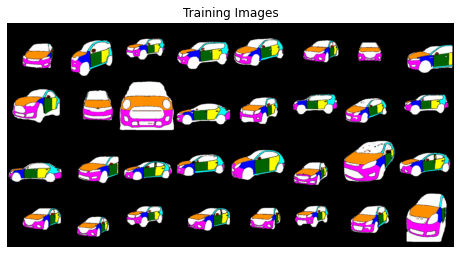

In [12]:
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))


In [13]:
# 

# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)


In [14]:
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d(     nz, ngf * 16, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 16),
            nn.ReLU(True),
            # state size. (ngf*16) x 4 x 4
            nn.ConvTranspose2d(ngf * 16, ngf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 8 x 8
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 16 x 16
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 32 x 32
            nn.ConvTranspose2d(ngf * 2,     ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 64 x 64
            nn.ConvTranspose2d(    ngf,      nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 128 x 128
        )

    def forward(self, input):
      return self.main(input)

In [15]:

# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 1024, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): BatchN

In [16]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            #input is (nc) x 128 x 128
            nn.Conv2d(nc, ndf, 4, stride=2, padding=1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 64 x 64
            nn.Conv2d(ndf, ndf * 2, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 32 x 32
            nn.Conv2d(ndf * 2, ndf * 4, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 16 x 16
            nn.Conv2d(ndf * 4, ndf * 8, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 8 x 8
            nn.Conv2d(ndf * 8, ndf * 16, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(ndf * 16),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*16) x 4 x 4
            nn.Conv2d(ndf * 16, 1, 4, stride=1, padding=0, bias=False),
            nn.Sigmoid()
            # state size. 1
        )

 
    def forward(self, input):
      return self.main(input)

In [17]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)


Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1024, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (12): BatchNorm2d(1024, eps=1e-05

In [18]:
netG = Generator(ngpu).to(device)
netD = Discriminator(ngpu).to(device)
optimizerD = optim.Adam(netD.parameters(), lr=lr_dis, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr_gen, betas=(beta1, 0.999))

In [19]:
# Initialize BCELoss function
criterion = nn.BCELoss()


In [20]:
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

In [21]:

# Establish convention for real and fake labels during training
real_label = 1
fake_label = 0


In [22]:
netG.train()
netD.train()
print(netG)
print(netD)


Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 1024, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): BatchN

In [23]:
model_path = '/content/drive/MyDrive/DC_check/'

Starting Training Loop...
[0/1000][6/7]	Loss_D: 0.0059	Loss_G: 5.6140	D(x): 0.9983	D(G(z)): 0.0042 / 0.0037


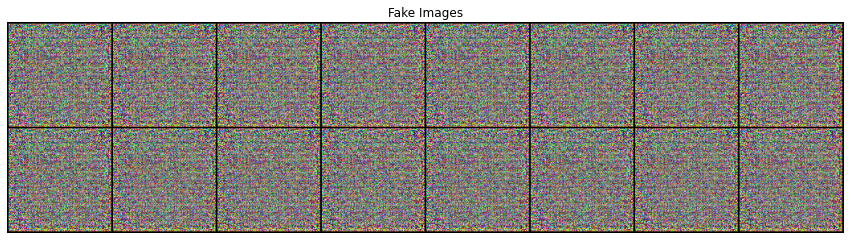

[1/1000][6/7]	Loss_D: 0.0063	Loss_G: 5.5045	D(x): 0.9986	D(G(z)): 0.0049 / 0.0041
[2/1000][6/7]	Loss_D: 0.0073	Loss_G: 5.3934	D(x): 0.9982	D(G(z)): 0.0055 / 0.0046
[3/1000][6/7]	Loss_D: 0.0068	Loss_G: 5.5027	D(x): 0.9980	D(G(z)): 0.0048 / 0.0041
[4/1000][6/7]	Loss_D: 0.0160	Loss_G: 5.1657	D(x): 0.9915	D(G(z)): 0.0073 / 0.0058
[5/1000][6/7]	Loss_D: 0.0066	Loss_G: 5.5609	D(x): 0.9981	D(G(z)): 0.0046 / 0.0039
[6/1000][6/7]	Loss_D: 0.0064	Loss_G: 5.5703	D(x): 0.9983	D(G(z)): 0.0047 / 0.0038
[7/1000][6/7]	Loss_D: 0.0074	Loss_G: 5.2999	D(x): 0.9991	D(G(z)): 0.0065 / 0.0050
[8/1000][6/7]	Loss_D: 0.0161	Loss_G: 5.3096	D(x): 0.9904	D(G(z)): 0.0063 / 0.0050
[9/1000][6/7]	Loss_D: 0.0055	Loss_G: 5.5636	D(x): 0.9990	D(G(z)): 0.0045 / 0.0039
[10/1000][6/7]	Loss_D: 0.0087	Loss_G: 5.1530	D(x): 0.9988	D(G(z)): 0.0075 / 0.0058
[11/1000][6/7]	Loss_D: 0.0092	Loss_G: 5.1767	D(x): 0.9980	D(G(z)): 0.0072 / 0.0057
[12/1000][6/7]	Loss_D: 0.0063	Loss_G: 5.6950	D(x): 0.9978	D(G(z)): 0.0041 / 0.0034
[13/1000][6/7

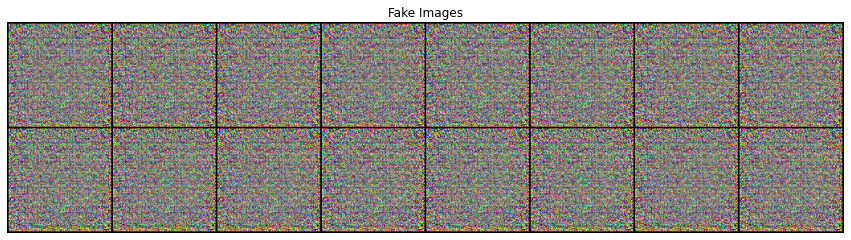

[21/1000][6/7]	Loss_D: 0.0053	Loss_G: 5.5410	D(x): 0.9994	D(G(z)): 0.0047 / 0.0039
[22/1000][6/7]	Loss_D: 0.0058	Loss_G: 5.5412	D(x): 0.9989	D(G(z)): 0.0047 / 0.0040
[23/1000][6/7]	Loss_D: 0.0059	Loss_G: 5.4999	D(x): 0.9989	D(G(z)): 0.0049 / 0.0041
[24/1000][6/7]	Loss_D: 0.0052	Loss_G: 5.9250	D(x): 0.9979	D(G(z)): 0.0030 / 0.0027
[25/1000][6/7]	Loss_D: 0.0047	Loss_G: 5.7089	D(x): 0.9994	D(G(z)): 0.0041 / 0.0034
[26/1000][6/7]	Loss_D: 0.0039	Loss_G: 5.9529	D(x): 0.9992	D(G(z)): 0.0030 / 0.0026
[27/1000][6/7]	Loss_D: 0.0068	Loss_G: 5.5563	D(x): 0.9979	D(G(z)): 0.0047 / 0.0039
[28/1000][6/7]	Loss_D: 0.0052	Loss_G: 5.6086	D(x): 0.9990	D(G(z)): 0.0043 / 0.0037
[29/1000][6/7]	Loss_D: 0.0070	Loss_G: 5.6237	D(x): 0.9973	D(G(z)): 0.0042 / 0.0037
[30/1000][6/7]	Loss_D: 0.0057	Loss_G: 5.5928	D(x): 0.9986	D(G(z)): 0.0043 / 0.0038
[31/1000][6/7]	Loss_D: 0.0078	Loss_G: 5.5072	D(x): 0.9969	D(G(z)): 0.0046 / 0.0041
[32/1000][6/7]	Loss_D: 0.0055	Loss_G: 5.7181	D(x): 0.9983	D(G(z)): 0.0037 / 0.0033
[33/

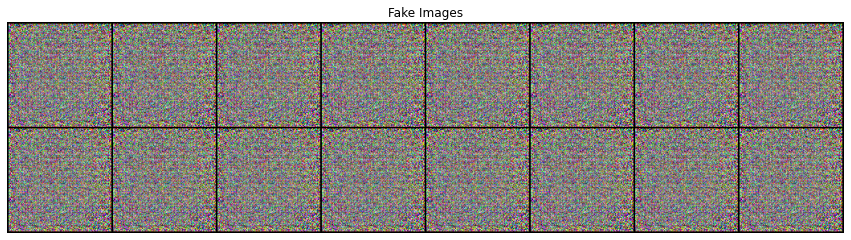

[41/1000][6/7]	Loss_D: 0.0052	Loss_G: 6.0522	D(x): 0.9974	D(G(z)): 0.0026 / 0.0024
[42/1000][6/7]	Loss_D: 0.0053	Loss_G: 5.7179	D(x): 0.9986	D(G(z)): 0.0039 / 0.0033
[43/1000][6/7]	Loss_D: 0.0067	Loss_G: 6.2519	D(x): 0.9954	D(G(z)): 0.0021 / 0.0019
[44/1000][6/7]	Loss_D: 0.0037	Loss_G: 6.3502	D(x): 0.9982	D(G(z)): 0.0019 / 0.0017
[45/1000][6/7]	Loss_D: 0.0033	Loss_G: 6.0969	D(x): 0.9992	D(G(z)): 0.0025 / 0.0023
[46/1000][6/7]	Loss_D: 0.0034	Loss_G: 6.0324	D(x): 0.9993	D(G(z)): 0.0027 / 0.0024
[47/1000][6/7]	Loss_D: 0.0053	Loss_G: 6.1630	D(x): 0.9969	D(G(z)): 0.0023 / 0.0021
[48/1000][6/7]	Loss_D: 0.0045	Loss_G: 6.3633	D(x): 0.9974	D(G(z)): 0.0019 / 0.0017
[49/1000][6/7]	Loss_D: 0.0038	Loss_G: 6.2061	D(x): 0.9985	D(G(z)): 0.0023 / 0.0021
[50/1000][6/7]	Loss_D: 0.0048	Loss_G: 5.8953	D(x): 0.9983	D(G(z)): 0.0031 / 0.0028
[51/1000][6/7]	Loss_D: 0.0058	Loss_G: 5.9646	D(x): 0.9971	D(G(z)): 0.0029 / 0.0026
[52/1000][6/7]	Loss_D: 0.0051	Loss_G: 5.8009	D(x): 0.9985	D(G(z)): 0.0036 / 0.0030
[53/

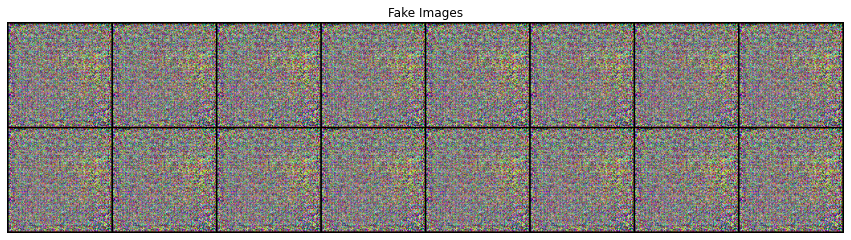

[61/1000][6/7]	Loss_D: 0.0050	Loss_G: 5.7715	D(x): 0.9986	D(G(z)): 0.0036 / 0.0031
[62/1000][6/7]	Loss_D: 0.0041	Loss_G: 5.9723	D(x): 0.9988	D(G(z)): 0.0030 / 0.0026
[63/1000][6/7]	Loss_D: 0.0065	Loss_G: 5.6621	D(x): 0.9977	D(G(z)): 0.0041 / 0.0035
[64/1000][6/7]	Loss_D: 0.0092	Loss_G: 5.5722	D(x): 0.9953	D(G(z)): 0.0045 / 0.0038
[65/1000][6/7]	Loss_D: 0.0077	Loss_G: 5.6883	D(x): 0.9960	D(G(z)): 0.0038 / 0.0034
[66/1000][6/7]	Loss_D: 0.0062	Loss_G: 5.6643	D(x): 0.9980	D(G(z)): 0.0042 / 0.0035
[67/1000][6/7]	Loss_D: 0.0154	Loss_G: 5.5444	D(x): 0.9890	D(G(z)): 0.0042 / 0.0039
[68/1000][6/7]	Loss_D: 0.0084	Loss_G: 5.8608	D(x): 0.9950	D(G(z)): 0.0033 / 0.0029
[69/1000][6/7]	Loss_D: 0.0073	Loss_G: 5.6323	D(x): 0.9970	D(G(z)): 0.0043 / 0.0036
[70/1000][6/7]	Loss_D: 0.0096	Loss_G: 5.8092	D(x): 0.9937	D(G(z)): 0.0033 / 0.0030
[71/1000][6/7]	Loss_D: 0.0055	Loss_G: 6.1668	D(x): 0.9969	D(G(z)): 0.0024 / 0.0021
[72/1000][6/7]	Loss_D: 0.0052	Loss_G: 5.7644	D(x): 0.9985	D(G(z)): 0.0037 / 0.0032
[73/

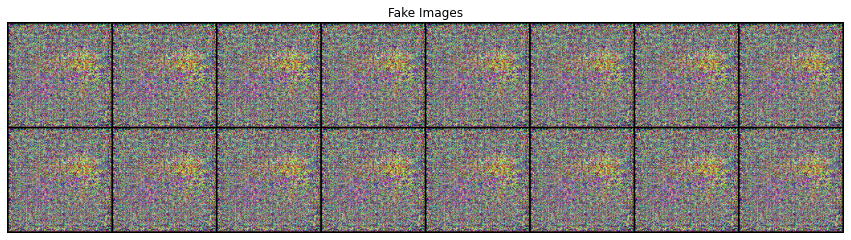

[81/1000][6/7]	Loss_D: 0.0108	Loss_G: 5.7625	D(x): 0.9930	D(G(z)): 0.0037 / 0.0032
[82/1000][6/7]	Loss_D: 0.0135	Loss_G: 5.7771	D(x): 0.9900	D(G(z)): 0.0034 / 0.0031
[83/1000][6/7]	Loss_D: 0.0135	Loss_G: 5.4811	D(x): 0.9916	D(G(z)): 0.0050 / 0.0042
[84/1000][6/7]	Loss_D: 0.0101	Loss_G: 5.4530	D(x): 0.9953	D(G(z)): 0.0053 / 0.0043
[85/1000][6/7]	Loss_D: 0.0068	Loss_G: 5.7795	D(x): 0.9966	D(G(z)): 0.0034 / 0.0031
[86/1000][6/7]	Loss_D: 0.0098	Loss_G: 5.6197	D(x): 0.9942	D(G(z)): 0.0040 / 0.0036
[87/1000][6/7]	Loss_D: 0.0068	Loss_G: 5.9688	D(x): 0.9960	D(G(z)): 0.0027 / 0.0026
[88/1000][6/7]	Loss_D: 0.0098	Loss_G: 5.2144	D(x): 0.9979	D(G(z)): 0.0077 / 0.0055
[89/1000][6/7]	Loss_D: 0.0202	Loss_G: 4.8878	D(x): 0.9904	D(G(z)): 0.0104 / 0.0076
[90/1000][6/7]	Loss_D: 0.0106	Loss_G: 5.3904	D(x): 0.9960	D(G(z)): 0.0066 / 0.0046
[91/1000][6/7]	Loss_D: 0.0462	Loss_G: 4.8620	D(x): 0.9609	D(G(z)): 0.0055 / 0.0078
[92/1000][6/7]	Loss_D: 0.0094	Loss_G: 6.1636	D(x): 0.9930	D(G(z)): 0.0023 / 0.0021
[93/

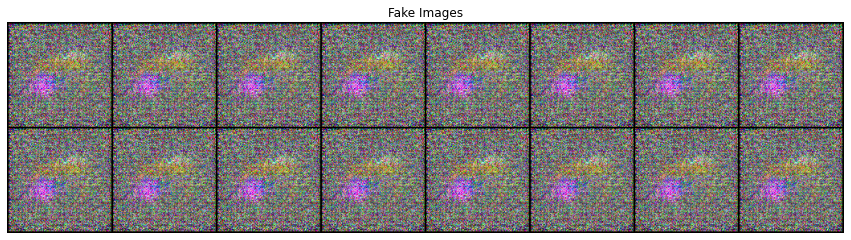

[101/1000][6/7]	Loss_D: 0.0060	Loss_G: 6.7876	D(x): 0.9952	D(G(z)): 0.0012 / 0.0011
[102/1000][6/7]	Loss_D: 0.0173	Loss_G: 4.3590	D(x): 0.9957	D(G(z)): 0.0129 / 0.0129
[103/1000][6/7]	Loss_D: 0.0173	Loss_G: 5.1311	D(x): 0.9885	D(G(z)): 0.0057 / 0.0060
[104/1000][6/7]	Loss_D: 0.0524	Loss_G: 4.2204	D(x): 0.9569	D(G(z)): 0.0075 / 0.0148
[105/1000][6/7]	Loss_D: 0.0115	Loss_G: 5.2743	D(x): 0.9942	D(G(z)): 0.0056 / 0.0051
[106/1000][6/7]	Loss_D: 0.0104	Loss_G: 5.4504	D(x): 0.9965	D(G(z)): 0.0068 / 0.0043
[107/1000][6/7]	Loss_D: 0.0135	Loss_G: 5.1030	D(x): 0.9975	D(G(z)): 0.0109 / 0.0061
[108/1000][6/7]	Loss_D: 0.0246	Loss_G: 5.1421	D(x): 0.9834	D(G(z)): 0.0077 / 0.0060
[109/1000][6/7]	Loss_D: 0.0098	Loss_G: 5.6590	D(x): 0.9955	D(G(z)): 0.0053 / 0.0035
[110/1000][6/7]	Loss_D: 0.0082	Loss_G: 5.7191	D(x): 0.9959	D(G(z)): 0.0041 / 0.0033
[111/1000][6/7]	Loss_D: 0.0065	Loss_G: 6.4660	D(x): 0.9953	D(G(z)): 0.0017 / 0.0016
[112/1000][6/7]	Loss_D: 0.0066	Loss_G: 6.0671	D(x): 0.9964	D(G(z)): 0.0029 /

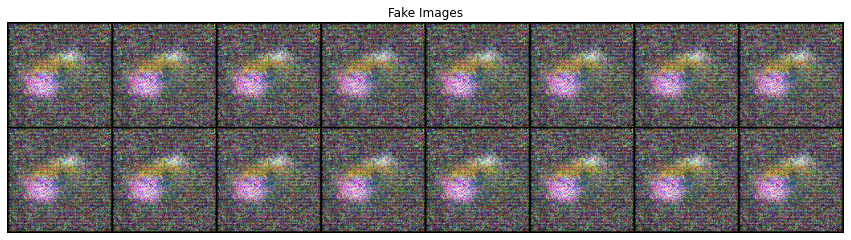

[121/1000][6/7]	Loss_D: 0.0092	Loss_G: 7.2006	D(x): 0.9936	D(G(z)): 0.0028 / 0.0007
[122/1000][6/7]	Loss_D: 0.0922	Loss_G: 8.4775	D(x): 0.9184	D(G(z)): 0.0002 / 0.0002
[123/1000][6/7]	Loss_D: 0.0465	Loss_G: 4.6374	D(x): 0.9596	D(G(z)): 0.0045 / 0.0098
[124/1000][6/7]	Loss_D: 0.0148	Loss_G: 5.3230	D(x): 0.9915	D(G(z)): 0.0063 / 0.0049
[125/1000][6/7]	Loss_D: 0.0239	Loss_G: 5.1539	D(x): 0.9833	D(G(z)): 0.0069 / 0.0058
[126/1000][6/7]	Loss_D: 0.0210	Loss_G: 6.4184	D(x): 0.9930	D(G(z)): 0.0139 / 0.0016
[127/1000][6/7]	Loss_D: 0.0616	Loss_G: 6.1203	D(x): 0.9795	D(G(z)): 0.0398 / 0.0022
[128/1000][6/7]	Loss_D: 0.3991	Loss_G: 1.1700	D(x): 0.8125	D(G(z)): 0.0363 / 0.3104
[129/1000][6/7]	Loss_D: 0.2834	Loss_G: 3.1408	D(x): 0.9013	D(G(z)): 0.1469 / 0.0433
[130/1000][6/7]	Loss_D: 0.7617	Loss_G: 2.6140	D(x): 0.6857	D(G(z)): 0.2051 / 0.0736
[131/1000][6/7]	Loss_D: 0.4171	Loss_G: 3.7436	D(x): 0.8054	D(G(z)): 0.1620 / 0.0238
[132/1000][6/7]	Loss_D: 0.5794	Loss_G: 2.3893	D(x): 0.7239	D(G(z)): 0.1182 /

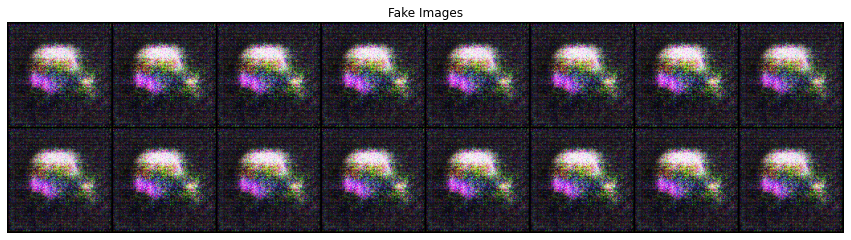

[141/1000][6/7]	Loss_D: 0.3329	Loss_G: 4.1547	D(x): 0.8021	D(G(z)): 0.0179 / 0.0157
[142/1000][6/7]	Loss_D: 0.5994	Loss_G: 1.2885	D(x): 0.6854	D(G(z)): 0.0461 / 0.2758
[143/1000][6/7]	Loss_D: 0.2883	Loss_G: 3.9611	D(x): 0.9068	D(G(z)): 0.0977 / 0.0191
[144/1000][6/7]	Loss_D: 0.1752	Loss_G: 4.6057	D(x): 0.9016	D(G(z)): 0.0420 / 0.0100
[145/1000][6/7]	Loss_D: 0.2482	Loss_G: 3.8279	D(x): 0.8749	D(G(z)): 0.0351 / 0.0218
[146/1000][6/7]	Loss_D: 0.3356	Loss_G: 3.2699	D(x): 0.8362	D(G(z)): 0.0995 / 0.0381
[147/1000][6/7]	Loss_D: 0.7766	Loss_G: 2.5879	D(x): 0.6157	D(G(z)): 0.0072 / 0.0755
[148/1000][6/7]	Loss_D: 0.2686	Loss_G: 3.2719	D(x): 0.8719	D(G(z)): 0.0376 / 0.0382
[149/1000][6/7]	Loss_D: 0.1906	Loss_G: 3.3198	D(x): 0.9117	D(G(z)): 0.0667 / 0.0363
[150/1000][6/7]	Loss_D: 0.3685	Loss_G: 2.9423	D(x): 0.8322	D(G(z)): 0.0594 / 0.0535
[151/1000][6/7]	Loss_D: 0.1571	Loss_G: 3.2213	D(x): 0.8978	D(G(z)): 0.0406 / 0.0407
[152/1000][6/7]	Loss_D: 0.1578	Loss_G: 3.5981	D(x): 0.9238	D(G(z)): 0.0695 /

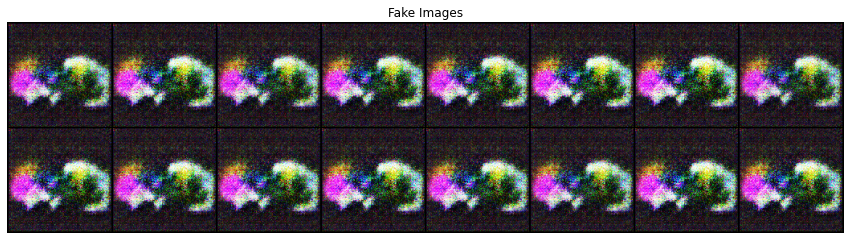

[161/1000][6/7]	Loss_D: 0.0758	Loss_G: 5.7205	D(x): 0.9380	D(G(z)): 0.0042 / 0.0033
[162/1000][6/7]	Loss_D: 1.0008	Loss_G: 1.1768	D(x): 0.5273	D(G(z)): 0.0109 / 0.3084
[163/1000][6/7]	Loss_D: 0.1135	Loss_G: 5.0729	D(x): 0.9351	D(G(z)): 0.0323 / 0.0063
[164/1000][6/7]	Loss_D: 0.1443	Loss_G: 4.2067	D(x): 0.9749	D(G(z)): 0.1092 / 0.0149
[165/1000][6/7]	Loss_D: 0.0589	Loss_G: 4.7335	D(x): 0.9919	D(G(z)): 0.0495 / 0.0088
[166/1000][6/7]	Loss_D: 0.3205	Loss_G: 4.0123	D(x): 0.8817	D(G(z)): 0.1471 / 0.0181
[167/1000][6/7]	Loss_D: 0.0387	Loss_G: 4.6505	D(x): 0.9860	D(G(z)): 0.0241 / 0.0096
[168/1000][6/7]	Loss_D: 0.0601	Loss_G: 4.0881	D(x): 0.9655	D(G(z)): 0.0233 / 0.0168
[169/1000][6/7]	Loss_D: 0.1984	Loss_G: 3.0083	D(x): 0.8575	D(G(z)): 0.0262 / 0.0495
[170/1000][6/7]	Loss_D: 0.1337	Loss_G: 3.8001	D(x): 0.8956	D(G(z)): 0.0110 / 0.0225
[171/1000][6/7]	Loss_D: 0.0856	Loss_G: 4.3592	D(x): 0.9581	D(G(z)): 0.0405 / 0.0129
[172/1000][6/7]	Loss_D: 0.1577	Loss_G: 4.0055	D(x): 0.9322	D(G(z)): 0.0793 /

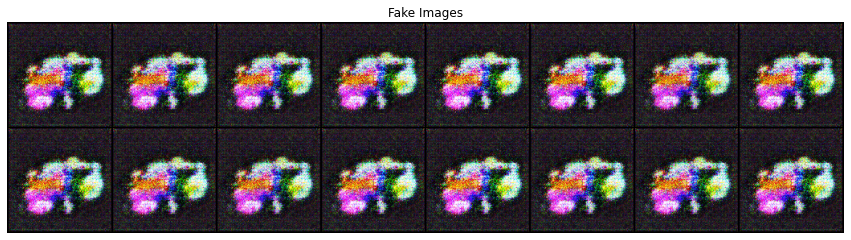

[181/1000][6/7]	Loss_D: 0.0728	Loss_G: 4.1072	D(x): 0.9643	D(G(z)): 0.0309 / 0.0165
[182/1000][6/7]	Loss_D: 0.0516	Loss_G: 5.1424	D(x): 0.9729	D(G(z)): 0.0232 / 0.0059
[183/1000][6/7]	Loss_D: 0.0803	Loss_G: 4.4899	D(x): 0.9625	D(G(z)): 0.0398 / 0.0113
[184/1000][6/7]	Loss_D: 0.0439	Loss_G: 4.7436	D(x): 0.9734	D(G(z)): 0.0162 / 0.0087
[185/1000][6/7]	Loss_D: 0.0391	Loss_G: 4.4632	D(x): 0.9774	D(G(z)): 0.0158 / 0.0116
[186/1000][6/7]	Loss_D: 0.0609	Loss_G: 6.0586	D(x): 0.9508	D(G(z)): 0.0096 / 0.0024
[187/1000][6/7]	Loss_D: 0.0465	Loss_G: 4.3311	D(x): 0.9774	D(G(z)): 0.0229 / 0.0132
[188/1000][6/7]	Loss_D: 0.2409	Loss_G: 2.5480	D(x): 0.8542	D(G(z)): 0.0179 / 0.0787
[189/1000][6/7]	Loss_D: 0.0343	Loss_G: 4.1835	D(x): 0.9904	D(G(z)): 0.0243 / 0.0153
[190/1000][6/7]	Loss_D: 0.0537	Loss_G: 4.3600	D(x): 0.9779	D(G(z)): 0.0305 / 0.0128
[191/1000][6/7]	Loss_D: 0.1143	Loss_G: 3.9977	D(x): 0.9266	D(G(z)): 0.0282 / 0.0184
[192/1000][6/7]	Loss_D: 0.0345	Loss_G: 4.6685	D(x): 0.9854	D(G(z)): 0.0191 /

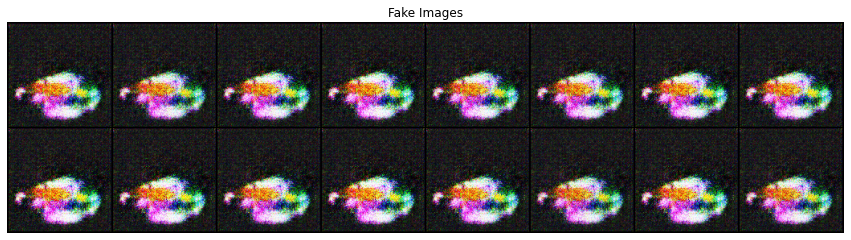

[201/1000][6/7]	Loss_D: 0.0836	Loss_G: 4.0286	D(x): 0.9517	D(G(z)): 0.0204 / 0.0179
[202/1000][6/7]	Loss_D: 0.0868	Loss_G: 3.6225	D(x): 0.9588	D(G(z)): 0.0314 / 0.0268
[203/1000][6/7]	Loss_D: 0.1611	Loss_G: 3.6752	D(x): 0.8915	D(G(z)): 0.0109 / 0.0254
[204/1000][6/7]	Loss_D: 0.0892	Loss_G: 4.9639	D(x): 0.9374	D(G(z)): 0.0067 / 0.0070
[205/1000][6/7]	Loss_D: 0.0193	Loss_G: 5.6863	D(x): 0.9911	D(G(z)): 0.0102 / 0.0034
[206/1000][6/7]	Loss_D: 0.0782	Loss_G: 5.1477	D(x): 0.9906	D(G(z)): 0.0663 / 0.0058
[207/1000][6/7]	Loss_D: 0.0948	Loss_G: 4.5963	D(x): 0.9315	D(G(z)): 0.0139 / 0.0102
[208/1000][6/7]	Loss_D: 0.1131	Loss_G: 3.6934	D(x): 0.9394	D(G(z)): 0.0453 / 0.0250
[209/1000][6/7]	Loss_D: 0.0784	Loss_G: 4.1335	D(x): 0.9613	D(G(z)): 0.0367 / 0.0161
[210/1000][6/7]	Loss_D: 0.2003	Loss_G: 5.7800	D(x): 0.9788	D(G(z)): 0.1633 / 0.0031
[211/1000][6/7]	Loss_D: 0.0445	Loss_G: 4.7218	D(x): 0.9799	D(G(z)): 0.0235 / 0.0089
[212/1000][6/7]	Loss_D: 0.0977	Loss_G: 4.1198	D(x): 0.9734	D(G(z)): 0.0655 /

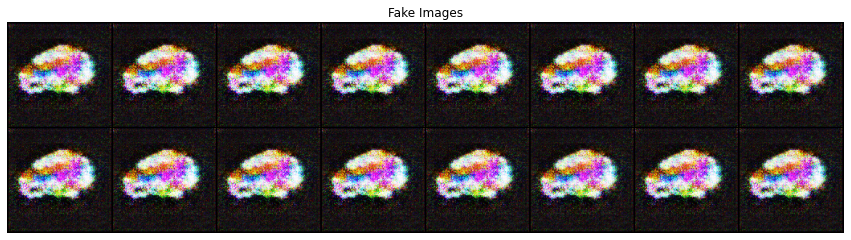

[221/1000][6/7]	Loss_D: 0.0569	Loss_G: 5.2729	D(x): 0.9655	D(G(z)): 0.0196 / 0.0051
[222/1000][6/7]	Loss_D: 0.0908	Loss_G: 4.7258	D(x): 0.9732	D(G(z)): 0.0605 / 0.0089
[223/1000][6/7]	Loss_D: 0.0789	Loss_G: 3.3403	D(x): 0.9386	D(G(z)): 0.0110 / 0.0355
[224/1000][6/7]	Loss_D: 0.0625	Loss_G: 4.3089	D(x): 0.9620	D(G(z)): 0.0213 / 0.0135
[225/1000][6/7]	Loss_D: 0.0867	Loss_G: 4.1493	D(x): 0.9471	D(G(z)): 0.0294 / 0.0158
[226/1000][6/7]	Loss_D: 0.1851	Loss_G: 2.9803	D(x): 0.8746	D(G(z)): 0.0334 / 0.0508
[227/1000][6/7]	Loss_D: 0.0637	Loss_G: 4.2491	D(x): 0.9527	D(G(z)): 0.0139 / 0.0143
[228/1000][6/7]	Loss_D: 0.0535	Loss_G: 4.3703	D(x): 0.9669	D(G(z)): 0.0184 / 0.0127
[229/1000][6/7]	Loss_D: 0.1157	Loss_G: 3.5003	D(x): 0.9326	D(G(z)): 0.0290 / 0.0303
[230/1000][6/7]	Loss_D: 0.0403	Loss_G: 5.1674	D(x): 0.9662	D(G(z)): 0.0054 / 0.0057
[231/1000][6/7]	Loss_D: 0.0405	Loss_G: 4.7341	D(x): 0.9766	D(G(z)): 0.0164 / 0.0088
[232/1000][6/7]	Loss_D: 0.0559	Loss_G: 4.4932	D(x): 0.9629	D(G(z)): 0.0159 /

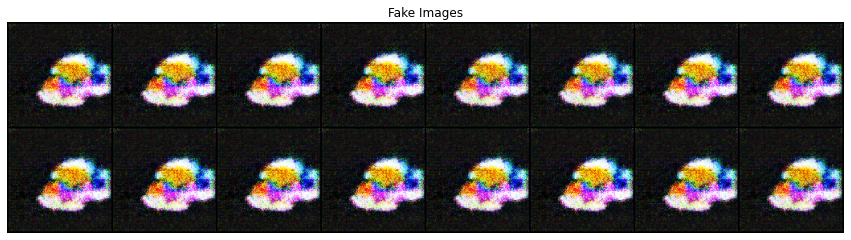

[241/1000][6/7]	Loss_D: 0.0283	Loss_G: 6.7628	D(x): 0.9783	D(G(z)): 0.0057 / 0.0012
[242/1000][6/7]	Loss_D: 0.0287	Loss_G: 5.0205	D(x): 0.9846	D(G(z)): 0.0127 / 0.0066
[243/1000][6/7]	Loss_D: 0.0264	Loss_G: 4.9436	D(x): 0.9917	D(G(z)): 0.0177 / 0.0071
[244/1000][6/7]	Loss_D: 0.0266	Loss_G: 4.8779	D(x): 0.9939	D(G(z)): 0.0202 / 0.0076
[245/1000][6/7]	Loss_D: 0.0383	Loss_G: 5.3243	D(x): 0.9814	D(G(z)): 0.0188 / 0.0049
[246/1000][6/7]	Loss_D: 0.0894	Loss_G: 4.5148	D(x): 0.9771	D(G(z)): 0.0640 / 0.0110
[247/1000][6/7]	Loss_D: 0.1526	Loss_G: 3.0487	D(x): 0.9057	D(G(z)): 0.0391 / 0.0474
[248/1000][6/7]	Loss_D: 0.0724	Loss_G: 4.6207	D(x): 0.9600	D(G(z)): 0.0192 / 0.0099
[249/1000][6/7]	Loss_D: 0.0143	Loss_G: 5.5188	D(x): 0.9963	D(G(z)): 0.0106 / 0.0040
[250/1000][6/7]	Loss_D: 0.0461	Loss_G: 4.9834	D(x): 0.9667	D(G(z)): 0.0101 / 0.0069
[251/1000][6/7]	Loss_D: 0.0289	Loss_G: 4.8430	D(x): 0.9916	D(G(z)): 0.0201 / 0.0079
[252/1000][6/7]	Loss_D: 0.0423	Loss_G: 3.9933	D(x): 0.9784	D(G(z)): 0.0197 /

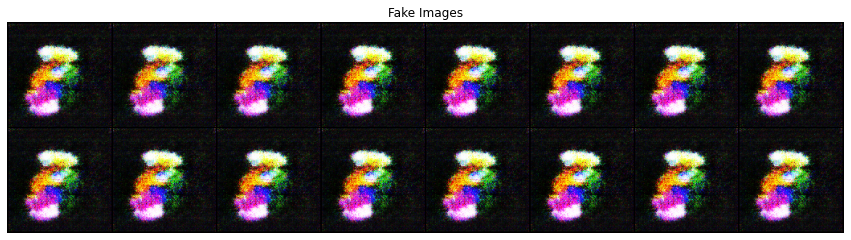

[261/1000][6/7]	Loss_D: 0.0344	Loss_G: 4.9473	D(x): 0.9889	D(G(z)): 0.0229 / 0.0071
[262/1000][6/7]	Loss_D: 0.0867	Loss_G: 4.5817	D(x): 0.9555	D(G(z)): 0.0327 / 0.0103
[263/1000][6/7]	Loss_D: 0.0580	Loss_G: 4.5369	D(x): 0.9814	D(G(z)): 0.0380 / 0.0108
[264/1000][6/7]	Loss_D: 0.1399	Loss_G: 4.0208	D(x): 0.9431	D(G(z)): 0.0582 / 0.0180
[265/1000][6/7]	Loss_D: 0.0368	Loss_G: 5.0610	D(x): 0.9925	D(G(z)): 0.0287 / 0.0064
[266/1000][6/7]	Loss_D: 0.0432	Loss_G: 4.8203	D(x): 0.9795	D(G(z)): 0.0209 / 0.0081
[267/1000][6/7]	Loss_D: 0.0400	Loss_G: 4.7460	D(x): 0.9829	D(G(z)): 0.0223 / 0.0087
[268/1000][6/7]	Loss_D: 0.0370	Loss_G: 4.5429	D(x): 0.9792	D(G(z)): 0.0140 / 0.0107
[269/1000][6/7]	Loss_D: 0.0453	Loss_G: 4.1751	D(x): 0.9814	D(G(z)): 0.0254 / 0.0154
[270/1000][6/7]	Loss_D: 0.0272	Loss_G: 4.5479	D(x): 0.9887	D(G(z)): 0.0151 / 0.0106
[271/1000][6/7]	Loss_D: 0.1165	Loss_G: 3.4870	D(x): 0.9274	D(G(z)): 0.0103 / 0.0306
[272/1000][6/7]	Loss_D: 0.0452	Loss_G: 4.5674	D(x): 0.9654	D(G(z)): 0.0069 /

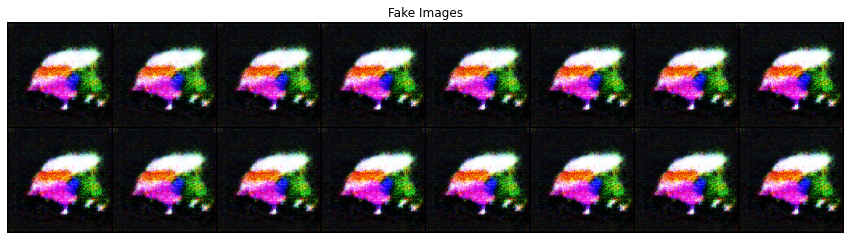

[281/1000][6/7]	Loss_D: 0.1639	Loss_G: 3.8376	D(x): 0.8750	D(G(z)): 0.0098 / 0.0216
[282/1000][6/7]	Loss_D: 0.0597	Loss_G: 4.2619	D(x): 0.9710	D(G(z)): 0.0273 / 0.0141
[283/1000][6/7]	Loss_D: 0.0406	Loss_G: 4.6970	D(x): 0.9743	D(G(z)): 0.0124 / 0.0091
[284/1000][6/7]	Loss_D: 0.0943	Loss_G: 3.9382	D(x): 0.9266	D(G(z)): 0.0064 / 0.0195
[285/1000][6/7]	Loss_D: 0.0111	Loss_G: 5.3274	D(x): 0.9941	D(G(z)): 0.0051 / 0.0049
[286/1000][6/7]	Loss_D: 0.0245	Loss_G: 4.9815	D(x): 0.9856	D(G(z)): 0.0096 / 0.0069
[287/1000][6/7]	Loss_D: 0.0122	Loss_G: 5.3393	D(x): 0.9966	D(G(z)): 0.0087 / 0.0048
[288/1000][6/7]	Loss_D: 0.0667	Loss_G: 4.2410	D(x): 0.9490	D(G(z)): 0.0091 / 0.0144
[289/1000][6/7]	Loss_D: 0.0226	Loss_G: 5.0941	D(x): 0.9877	D(G(z)): 0.0100 / 0.0062
[290/1000][6/7]	Loss_D: 0.0148	Loss_G: 5.1640	D(x): 0.9966	D(G(z)): 0.0114 / 0.0058
[291/1000][6/7]	Loss_D: 0.1081	Loss_G: 3.8843	D(x): 0.9364	D(G(z)): 0.0178 / 0.0206
[292/1000][6/7]	Loss_D: 0.0339	Loss_G: 4.5326	D(x): 0.9883	D(G(z)): 0.0217 /

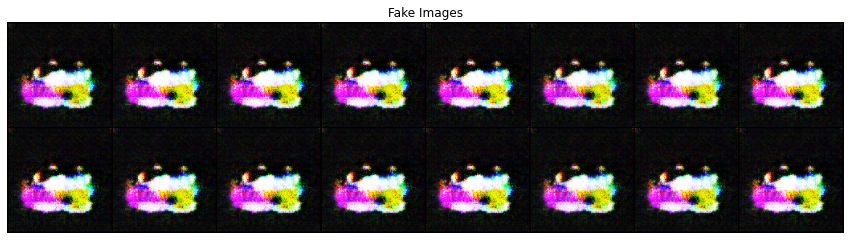

[301/1000][6/7]	Loss_D: 0.0687	Loss_G: 5.3053	D(x): 0.9820	D(G(z)): 0.0491 / 0.0050
[302/1000][6/7]	Loss_D: 0.1208	Loss_G: 3.9684	D(x): 0.9364	D(G(z)): 0.0402 / 0.0189
[303/1000][6/7]	Loss_D: 0.0273	Loss_G: 5.3090	D(x): 0.9840	D(G(z)): 0.0109 / 0.0050
[304/1000][6/7]	Loss_D: 0.0237	Loss_G: 5.3663	D(x): 0.9880	D(G(z)): 0.0115 / 0.0047
[305/1000][6/7]	Loss_D: 0.0124	Loss_G: 5.4151	D(x): 0.9945	D(G(z)): 0.0069 / 0.0045
[306/1000][6/7]	Loss_D: 0.0177	Loss_G: 5.3693	D(x): 0.9885	D(G(z)): 0.0059 / 0.0047
[307/1000][6/7]	Loss_D: 0.0112	Loss_G: 5.4723	D(x): 0.9949	D(G(z)): 0.0060 / 0.0042
[308/1000][6/7]	Loss_D: 0.0151	Loss_G: 5.1933	D(x): 0.9959	D(G(z)): 0.0110 / 0.0056
[309/1000][6/7]	Loss_D: 0.0151	Loss_G: 5.2768	D(x): 0.9929	D(G(z)): 0.0078 / 0.0051
[310/1000][6/7]	Loss_D: 0.0607	Loss_G: 4.3783	D(x): 0.9568	D(G(z)): 0.0069 / 0.0126
[311/1000][6/7]	Loss_D: 0.0107	Loss_G: 5.6095	D(x): 0.9938	D(G(z)): 0.0044 / 0.0037
[312/1000][6/7]	Loss_D: 0.0102	Loss_G: 5.4457	D(x): 0.9958	D(G(z)): 0.0060 /

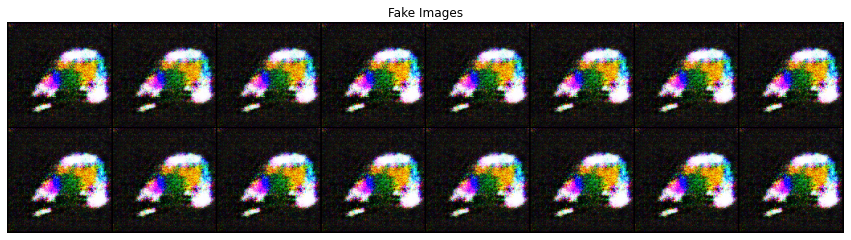

[321/1000][6/7]	Loss_D: 0.0417	Loss_G: 4.5814	D(x): 0.9802	D(G(z)): 0.0212 / 0.0102
[322/1000][6/7]	Loss_D: 0.0139	Loss_G: 5.3462	D(x): 0.9952	D(G(z)): 0.0090 / 0.0048
[323/1000][6/7]	Loss_D: 0.0198	Loss_G: 5.2189	D(x): 0.9935	D(G(z)): 0.0132 / 0.0054
[324/1000][6/7]	Loss_D: 0.0195	Loss_G: 5.2605	D(x): 0.9928	D(G(z)): 0.0123 / 0.0052
[325/1000][6/7]	Loss_D: 0.0226	Loss_G: 5.1266	D(x): 0.9860	D(G(z)): 0.0081 / 0.0059
[326/1000][6/7]	Loss_D: 0.0173	Loss_G: 5.2729	D(x): 0.9905	D(G(z)): 0.0077 / 0.0051
[327/1000][6/7]	Loss_D: 0.0768	Loss_G: 3.5465	D(x): 0.9450	D(G(z)): 0.0171 / 0.0288
[328/1000][6/7]	Loss_D: 0.0179	Loss_G: 5.7821	D(x): 0.9874	D(G(z)): 0.0051 / 0.0031
[329/1000][6/7]	Loss_D: 0.0177	Loss_G: 5.3404	D(x): 0.9883	D(G(z)): 0.0058 / 0.0048
[330/1000][6/7]	Loss_D: 0.0361	Loss_G: 4.8407	D(x): 0.9719	D(G(z)): 0.0068 / 0.0079
[331/1000][6/7]	Loss_D: 0.0403	Loss_G: 4.3216	D(x): 0.9743	D(G(z)): 0.0115 / 0.0133
[332/1000][6/7]	Loss_D: 0.0919	Loss_G: 6.0853	D(x): 0.9675	D(G(z)): 0.0557 /

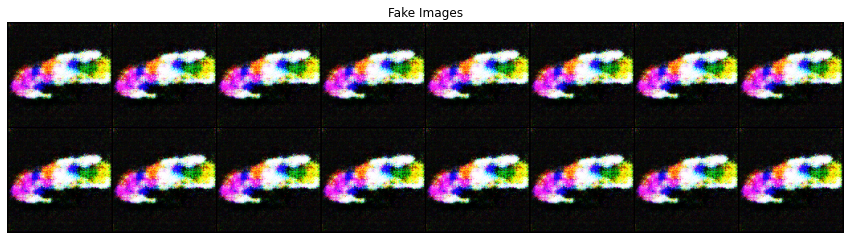

[341/1000][6/7]	Loss_D: 0.0319	Loss_G: 5.5417	D(x): 0.9913	D(G(z)): 0.0227 / 0.0039
[342/1000][6/7]	Loss_D: 0.0128	Loss_G: 6.3815	D(x): 0.9887	D(G(z)): 0.0014 / 0.0017
[343/1000][6/7]	Loss_D: 0.0170	Loss_G: 5.3020	D(x): 0.9900	D(G(z)): 0.0068 / 0.0050
[344/1000][6/7]	Loss_D: 0.0123	Loss_G: 5.4453	D(x): 0.9975	D(G(z)): 0.0097 / 0.0043
[345/1000][6/7]	Loss_D: 0.0233	Loss_G: 5.0989	D(x): 0.9890	D(G(z)): 0.0121 / 0.0061
[346/1000][6/7]	Loss_D: 0.0368	Loss_G: 4.5231	D(x): 0.9773	D(G(z)): 0.0133 / 0.0109
[347/1000][6/7]	Loss_D: 0.0293	Loss_G: 4.6480	D(x): 0.9883	D(G(z)): 0.0172 / 0.0096
[348/1000][6/7]	Loss_D: 0.0156	Loss_G: 4.8019	D(x): 0.9960	D(G(z)): 0.0115 / 0.0082
[349/1000][6/7]	Loss_D: 0.0092	Loss_G: 5.2990	D(x): 0.9984	D(G(z)): 0.0076 / 0.0050
[350/1000][6/7]	Loss_D: 0.0099	Loss_G: 5.3423	D(x): 0.9974	D(G(z)): 0.0073 / 0.0048
[351/1000][6/7]	Loss_D: 0.0187	Loss_G: 5.0737	D(x): 0.9967	D(G(z)): 0.0153 / 0.0063
[352/1000][6/7]	Loss_D: 0.1008	Loss_G: 3.3300	D(x): 0.9335	D(G(z)): 0.0080 /

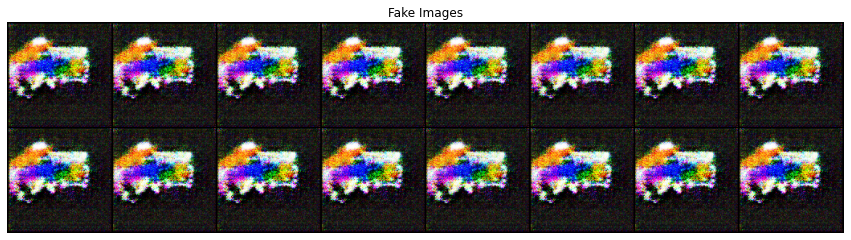

[361/1000][6/7]	Loss_D: 0.0050	Loss_G: 5.9722	D(x): 0.9989	D(G(z)): 0.0038 / 0.0026
[362/1000][6/7]	Loss_D: 0.0098	Loss_G: 5.5993	D(x): 0.9962	D(G(z)): 0.0060 / 0.0037
[363/1000][6/7]	Loss_D: 0.0756	Loss_G: 3.5711	D(x): 0.9440	D(G(z)): 0.0116 / 0.0282
[364/1000][6/7]	Loss_D: 0.0292	Loss_G: 5.9187	D(x): 0.9978	D(G(z)): 0.0266 / 0.0027
[365/1000][6/7]	Loss_D: 0.1970	Loss_G: 1.1555	D(x): 0.8530	D(G(z)): 0.0087 / 0.3149
[366/1000][6/7]	Loss_D: 0.4762	Loss_G: 9.4019	D(x): 0.9977	D(G(z)): 0.3772 / 0.0001
[367/1000][6/7]	Loss_D: 0.6798	Loss_G: 14.6188	D(x): 0.6794	D(G(z)): 0.0000 / 0.0000
[368/1000][6/7]	Loss_D: 0.2216	Loss_G: 5.8907	D(x): 0.9399	D(G(z)): 0.1254 / 0.0029
[369/1000][6/7]	Loss_D: 0.1891	Loss_G: 6.0867	D(x): 0.8667	D(G(z)): 0.0058 / 0.0023
[370/1000][6/7]	Loss_D: 0.0673	Loss_G: 6.5782	D(x): 0.9462	D(G(z)): 0.0082 / 0.0014
[371/1000][6/7]	Loss_D: 0.0744	Loss_G: 4.6808	D(x): 0.9833	D(G(z)): 0.0556 / 0.0095
[372/1000][6/7]	Loss_D: 0.0328	Loss_G: 4.6647	D(x): 0.9919	D(G(z)): 0.0243 

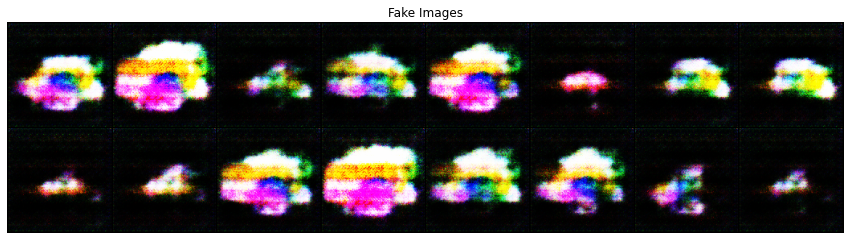

[381/1000][6/7]	Loss_D: 0.6291	Loss_G: 4.2157	D(x): 0.9465	D(G(z)): 0.3750 / 0.0247
[382/1000][6/7]	Loss_D: 0.2491	Loss_G: 3.8894	D(x): 0.8719	D(G(z)): 0.0554 / 0.0359
[383/1000][6/7]	Loss_D: 0.3930	Loss_G: 5.3284	D(x): 0.7551	D(G(z)): 0.0031 / 0.0069
[384/1000][6/7]	Loss_D: 0.3072	Loss_G: 4.5020	D(x): 0.9247	D(G(z)): 0.1583 / 0.0229
[385/1000][6/7]	Loss_D: 0.2366	Loss_G: 3.8406	D(x): 0.9324	D(G(z)): 0.1410 / 0.0255
[386/1000][6/7]	Loss_D: 1.7466	Loss_G: 3.0461	D(x): 0.3341	D(G(z)): 0.0015 / 0.1392
[387/1000][6/7]	Loss_D: 0.4170	Loss_G: 2.1642	D(x): 0.7892	D(G(z)): 0.1196 / 0.1415
[388/1000][6/7]	Loss_D: 0.5842	Loss_G: 0.9361	D(x): 0.7150	D(G(z)): 0.1294 / 0.4656
[389/1000][6/7]	Loss_D: 1.0091	Loss_G: 1.4938	D(x): 0.4073	D(G(z)): 0.0046 / 0.2918
[390/1000][6/7]	Loss_D: 0.3262	Loss_G: 3.3950	D(x): 0.8250	D(G(z)): 0.0993 / 0.0518
[391/1000][6/7]	Loss_D: 0.4794	Loss_G: 1.7102	D(x): 0.8075	D(G(z)): 0.1585 / 0.2255
[392/1000][6/7]	Loss_D: 0.2730	Loss_G: 3.1802	D(x): 0.8037	D(G(z)): 0.0328 /

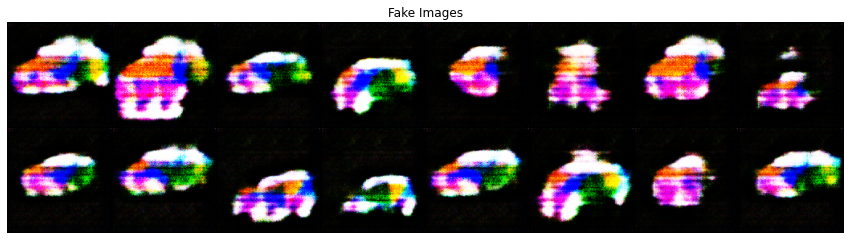

[401/1000][6/7]	Loss_D: 0.4242	Loss_G: 3.2884	D(x): 0.9085	D(G(z)): 0.2543 / 0.0484
[402/1000][6/7]	Loss_D: 0.3591	Loss_G: 1.7004	D(x): 0.7667	D(G(z)): 0.0698 / 0.2484
[403/1000][6/7]	Loss_D: 1.9310	Loss_G: 4.7766	D(x): 0.9959	D(G(z)): 0.8085 / 0.0133
[404/1000][6/7]	Loss_D: 0.5692	Loss_G: 1.6934	D(x): 0.6561	D(G(z)): 0.1023 / 0.3208
[405/1000][6/7]	Loss_D: 0.4889	Loss_G: 1.9584	D(x): 0.7278	D(G(z)): 0.1132 / 0.2503
[406/1000][6/7]	Loss_D: 0.3558	Loss_G: 2.4757	D(x): 0.8767	D(G(z)): 0.1913 / 0.1007
[407/1000][6/7]	Loss_D: 0.3013	Loss_G: 2.2500	D(x): 0.8439	D(G(z)): 0.1145 / 0.1443
[408/1000][6/7]	Loss_D: 0.3377	Loss_G: 2.5495	D(x): 0.8275	D(G(z)): 0.1281 / 0.0992
[409/1000][6/7]	Loss_D: 0.2688	Loss_G: 2.0915	D(x): 0.8105	D(G(z)): 0.0504 / 0.1561
[410/1000][6/7]	Loss_D: 1.1835	Loss_G: 0.4490	D(x): 0.3471	D(G(z)): 0.0044 / 0.6525
[411/1000][6/7]	Loss_D: 0.4501	Loss_G: 1.8005	D(x): 0.7345	D(G(z)): 0.1035 / 0.1930
[412/1000][6/7]	Loss_D: 0.4392	Loss_G: 1.3207	D(x): 0.6879	D(G(z)): 0.0361 /

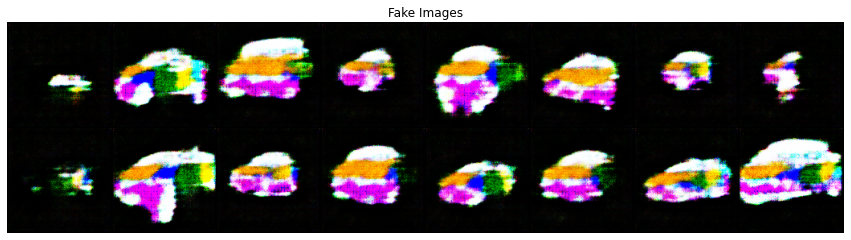

[421/1000][6/7]	Loss_D: 0.2986	Loss_G: 2.9694	D(x): 0.8956	D(G(z)): 0.1611 / 0.0648
[422/1000][6/7]	Loss_D: 1.3124	Loss_G: 1.4906	D(x): 0.3174	D(G(z)): 0.0070 / 0.2962
[423/1000][6/7]	Loss_D: 0.3338	Loss_G: 2.0564	D(x): 0.8262	D(G(z)): 0.1116 / 0.1443
[424/1000][6/7]	Loss_D: 0.1374	Loss_G: 3.4414	D(x): 0.9507	D(G(z)): 0.0806 / 0.0380
[425/1000][6/7]	Loss_D: 0.8667	Loss_G: 0.4235	D(x): 0.4682	D(G(z)): 0.0446 / 0.6888
[426/1000][6/7]	Loss_D: 0.7540	Loss_G: 0.8958	D(x): 0.5250	D(G(z)): 0.0402 / 0.4483
[427/1000][6/7]	Loss_D: 0.2952	Loss_G: 2.8463	D(x): 0.8943	D(G(z)): 0.1619 / 0.0669
[428/1000][6/7]	Loss_D: 0.3320	Loss_G: 3.5025	D(x): 0.9735	D(G(z)): 0.2558 / 0.0371
[429/1000][6/7]	Loss_D: 0.6777	Loss_G: 2.4074	D(x): 0.5940	D(G(z)): 0.0530 / 0.1254
[430/1000][6/7]	Loss_D: 0.4706	Loss_G: 2.7365	D(x): 0.8872	D(G(z)): 0.2730 / 0.0899
[431/1000][6/7]	Loss_D: 0.6051	Loss_G: 1.3790	D(x): 0.5846	D(G(z)): 0.0152 / 0.2769
[432/1000][6/7]	Loss_D: 1.0325	Loss_G: 1.2574	D(x): 0.4429	D(G(z)): 0.0442 /

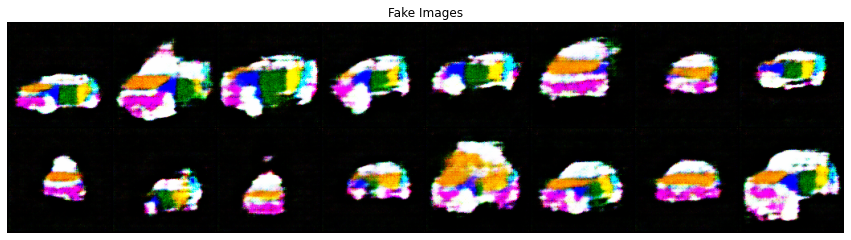

[441/1000][6/7]	Loss_D: 0.4459	Loss_G: 4.0810	D(x): 0.9671	D(G(z)): 0.3171 / 0.0201
[442/1000][6/7]	Loss_D: 0.6245	Loss_G: 0.3408	D(x): 0.5695	D(G(z)): 0.0262 / 0.7355
[443/1000][6/7]	Loss_D: 0.2634	Loss_G: 3.8032	D(x): 0.9066	D(G(z)): 0.1454 / 0.0286
[444/1000][6/7]	Loss_D: 0.5372	Loss_G: 0.9093	D(x): 0.6249	D(G(z)): 0.0437 / 0.4648
[445/1000][6/7]	Loss_D: 0.2863	Loss_G: 2.7585	D(x): 0.9518	D(G(z)): 0.1979 / 0.0768
[446/1000][6/7]	Loss_D: 0.2708	Loss_G: 2.8403	D(x): 0.8259	D(G(z)): 0.0609 / 0.0716
[447/1000][6/7]	Loss_D: 0.4280	Loss_G: 4.5184	D(x): 0.9500	D(G(z)): 0.3017 / 0.0130
[448/1000][6/7]	Loss_D: 0.4044	Loss_G: 2.5939	D(x): 0.7972	D(G(z)): 0.1445 / 0.0909
[449/1000][6/7]	Loss_D: 0.3529	Loss_G: 2.1650	D(x): 0.7751	D(G(z)): 0.0761 / 0.1340
[450/1000][6/7]	Loss_D: 0.3037	Loss_G: 2.8655	D(x): 0.8910	D(G(z)): 0.1644 / 0.0683
[451/1000][6/7]	Loss_D: 1.6943	Loss_G: 1.0111	D(x): 0.2909	D(G(z)): 0.0241 / 0.4749
[452/1000][6/7]	Loss_D: 0.9123	Loss_G: 4.3686	D(x): 0.9673	D(G(z)): 0.5149 /

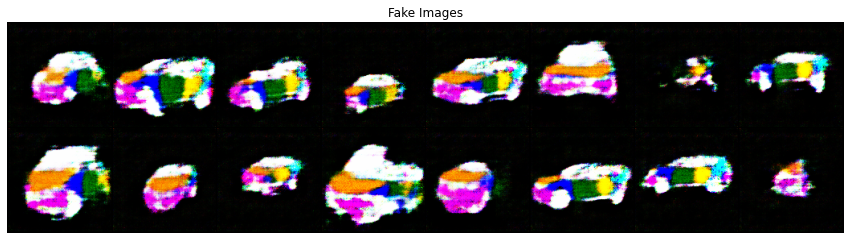

[461/1000][6/7]	Loss_D: 0.1826	Loss_G: 2.6046	D(x): 0.8895	D(G(z)): 0.0594 / 0.0863
[462/1000][6/7]	Loss_D: 0.2339	Loss_G: 2.3651	D(x): 0.8575	D(G(z)): 0.0737 / 0.1121
[463/1000][6/7]	Loss_D: 0.9419	Loss_G: 2.0391	D(x): 0.4882	D(G(z)): 0.0313 / 0.2258
[464/1000][6/7]	Loss_D: 0.2122	Loss_G: 2.9469	D(x): 0.8774	D(G(z)): 0.0748 / 0.0627
[465/1000][6/7]	Loss_D: 0.4123	Loss_G: 2.0890	D(x): 0.8105	D(G(z)): 0.1758 / 0.1370
[466/1000][6/7]	Loss_D: 0.3222	Loss_G: 2.5882	D(x): 0.8686	D(G(z)): 0.1563 / 0.0950
[467/1000][6/7]	Loss_D: 0.1745	Loss_G: 1.7689	D(x): 0.9196	D(G(z)): 0.0838 / 0.1929
[468/1000][6/7]	Loss_D: 0.2483	Loss_G: 2.4474	D(x): 0.9303	D(G(z)): 0.1515 / 0.1119
[469/1000][6/7]	Loss_D: 0.2954	Loss_G: 2.4975	D(x): 0.8941	D(G(z)): 0.1552 / 0.0993
[470/1000][6/7]	Loss_D: 0.1945	Loss_G: 3.2653	D(x): 0.8668	D(G(z)): 0.0421 / 0.0534
[471/1000][6/7]	Loss_D: 0.2382	Loss_G: 2.3324	D(x): 0.8928	D(G(z)): 0.1118 / 0.1095
[472/1000][6/7]	Loss_D: 0.2576	Loss_G: 3.1178	D(x): 0.8521	D(G(z)): 0.0863 /

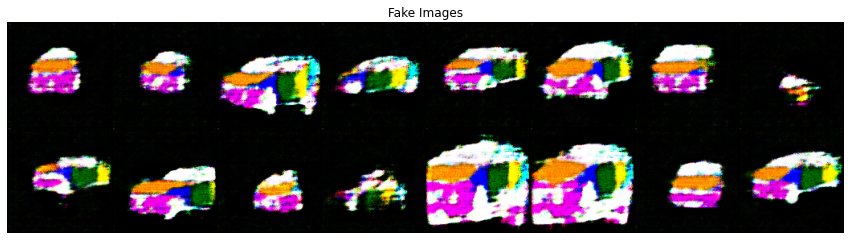

[481/1000][6/7]	Loss_D: 0.1657	Loss_G: 2.6322	D(x): 0.9526	D(G(z)): 0.1078 / 0.0942
[482/1000][6/7]	Loss_D: 0.1721	Loss_G: 3.0299	D(x): 0.9500	D(G(z)): 0.1084 / 0.0577
[483/1000][6/7]	Loss_D: 0.1403	Loss_G: 2.5248	D(x): 0.9335	D(G(z)): 0.0663 / 0.1119
[484/1000][6/7]	Loss_D: 0.3597	Loss_G: 1.4532	D(x): 0.7539	D(G(z)): 0.0628 / 0.2589
[485/1000][6/7]	Loss_D: 0.2720	Loss_G: 3.0574	D(x): 0.8628	D(G(z)): 0.1128 / 0.0589
[486/1000][6/7]	Loss_D: 0.2447	Loss_G: 2.2872	D(x): 0.9517	D(G(z)): 0.1667 / 0.1274
[487/1000][6/7]	Loss_D: 0.3998	Loss_G: 2.2092	D(x): 0.7477	D(G(z)): 0.0854 / 0.1373
[488/1000][6/7]	Loss_D: 0.3459	Loss_G: 2.0473	D(x): 0.8084	D(G(z)): 0.1134 / 0.1595
[489/1000][6/7]	Loss_D: 0.3547	Loss_G: 2.8141	D(x): 0.8410	D(G(z)): 0.1389 / 0.0843
[490/1000][6/7]	Loss_D: 0.8361	Loss_G: 0.7280	D(x): 0.4748	D(G(z)): 0.0226 / 0.5726
[491/1000][6/7]	Loss_D: 0.4024	Loss_G: 2.1598	D(x): 0.8175	D(G(z)): 0.1488 / 0.1576
[492/1000][6/7]	Loss_D: 0.2819	Loss_G: 2.4789	D(x): 0.8396	D(G(z)): 0.0864 /

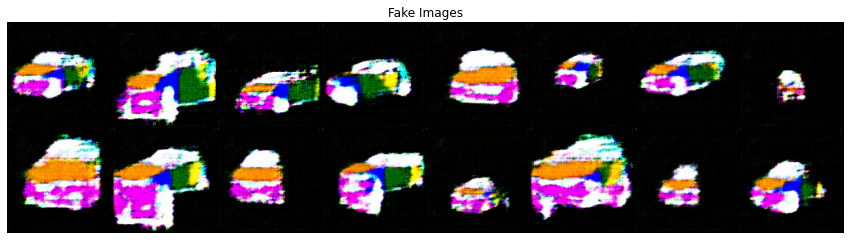

[501/1000][6/7]	Loss_D: 0.2084	Loss_G: 2.8959	D(x): 0.8426	D(G(z)): 0.0335 / 0.0985
[502/1000][6/7]	Loss_D: 0.1412	Loss_G: 3.5277	D(x): 0.9688	D(G(z)): 0.1015 / 0.0384
[503/1000][6/7]	Loss_D: 0.1271	Loss_G: 2.8626	D(x): 0.9340	D(G(z)): 0.0543 / 0.0645
[504/1000][6/7]	Loss_D: 1.0307	Loss_G: 0.4294	D(x): 0.4216	D(G(z)): 0.0062 / 0.7360
[505/1000][6/7]	Loss_D: 0.6095	Loss_G: 4.8150	D(x): 0.8708	D(G(z)): 0.3490 / 0.0101
[506/1000][6/7]	Loss_D: 0.3710	Loss_G: 2.0046	D(x): 0.7709	D(G(z)): 0.0862 / 0.1612
[507/1000][6/7]	Loss_D: 0.4867	Loss_G: 4.6704	D(x): 0.9493	D(G(z)): 0.3255 / 0.0113
[508/1000][6/7]	Loss_D: 0.5847	Loss_G: 4.4853	D(x): 0.9893	D(G(z)): 0.4029 / 0.0142
[509/1000][6/7]	Loss_D: 0.1915	Loss_G: 3.9383	D(x): 0.9377	D(G(z)): 0.1136 / 0.0244
[510/1000][6/7]	Loss_D: 0.1001	Loss_G: 2.5556	D(x): 0.9390	D(G(z)): 0.0356 / 0.1032
[511/1000][6/7]	Loss_D: 0.4214	Loss_G: 3.3150	D(x): 0.9504	D(G(z)): 0.2793 / 0.0425
[512/1000][6/7]	Loss_D: 0.0891	Loss_G: 3.7950	D(x): 0.9591	D(G(z)): 0.0455 /

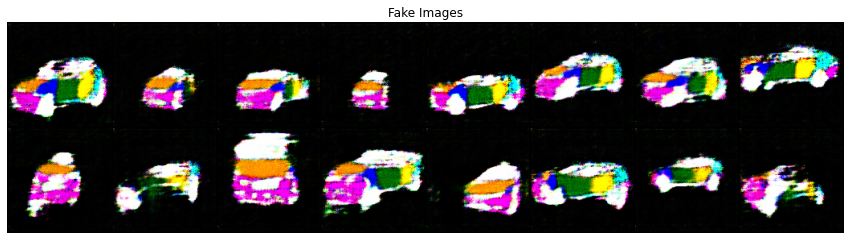

[521/1000][6/7]	Loss_D: 0.3195	Loss_G: 4.4057	D(x): 0.9845	D(G(z)): 0.2440 / 0.0171
[522/1000][6/7]	Loss_D: 0.8729	Loss_G: 3.3099	D(x): 0.8233	D(G(z)): 0.4569 / 0.0449
[523/1000][6/7]	Loss_D: 0.3111	Loss_G: 1.4248	D(x): 0.7590	D(G(z)): 0.0278 / 0.2926
[524/1000][6/7]	Loss_D: 0.1116	Loss_G: 3.0691	D(x): 0.9476	D(G(z)): 0.0541 / 0.0577
[525/1000][6/7]	Loss_D: 0.1379	Loss_G: 3.7013	D(x): 0.9442	D(G(z)): 0.0739 / 0.0348
[526/1000][6/7]	Loss_D: 0.1005	Loss_G: 3.4005	D(x): 0.9645	D(G(z)): 0.0604 / 0.0421
[527/1000][6/7]	Loss_D: 0.1517	Loss_G: 2.9296	D(x): 0.9145	D(G(z)): 0.0589 / 0.0683
[528/1000][6/7]	Loss_D: 0.1736	Loss_G: 2.2532	D(x): 0.8654	D(G(z)): 0.0270 / 0.1187
[529/1000][6/7]	Loss_D: 0.2194	Loss_G: 3.9838	D(x): 0.9540	D(G(z)): 0.1530 / 0.0213
[530/1000][6/7]	Loss_D: 0.2179	Loss_G: 3.7554	D(x): 0.9739	D(G(z)): 0.1648 / 0.0287
[531/1000][6/7]	Loss_D: 0.1860	Loss_G: 2.5285	D(x): 0.8658	D(G(z)): 0.0365 / 0.1044
[532/1000][6/7]	Loss_D: 0.2051	Loss_G: 2.2700	D(x): 0.8377	D(G(z)): 0.0191 /

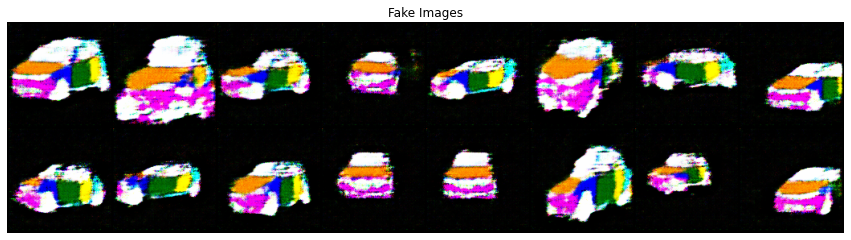

[541/1000][6/7]	Loss_D: 0.1820	Loss_G: 3.2947	D(x): 0.9404	D(G(z)): 0.1103 / 0.0428
[542/1000][6/7]	Loss_D: 0.2649	Loss_G: 2.9028	D(x): 0.9589	D(G(z)): 0.1932 / 0.0621
[543/1000][6/7]	Loss_D: 0.2177	Loss_G: 2.4494	D(x): 0.8567	D(G(z)): 0.0585 / 0.1095
[544/1000][6/7]	Loss_D: 0.1360	Loss_G: 3.4420	D(x): 0.9152	D(G(z)): 0.0449 / 0.0450
[545/1000][6/7]	Loss_D: 0.1310	Loss_G: 3.3629	D(x): 0.9209	D(G(z)): 0.0455 / 0.0427
[546/1000][6/7]	Loss_D: 0.0934	Loss_G: 4.0258	D(x): 0.9450	D(G(z)): 0.0355 / 0.0218
[547/1000][6/7]	Loss_D: 0.2114	Loss_G: 2.6972	D(x): 0.8457	D(G(z)): 0.0373 / 0.1034
[548/1000][6/7]	Loss_D: 0.2300	Loss_G: 2.7261	D(x): 0.8271	D(G(z)): 0.0344 / 0.0997
[549/1000][6/7]	Loss_D: 0.0948	Loss_G: 4.1596	D(x): 0.9417	D(G(z)): 0.0334 / 0.0218
[550/1000][6/7]	Loss_D: 0.2271	Loss_G: 2.3636	D(x): 0.8907	D(G(z)): 0.1004 / 0.1171
[551/1000][6/7]	Loss_D: 0.0781	Loss_G: 5.2907	D(x): 0.9561	D(G(z)): 0.0315 / 0.0125
[552/1000][6/7]	Loss_D: 0.2318	Loss_G: 2.3355	D(x): 0.8336	D(G(z)): 0.0411 /

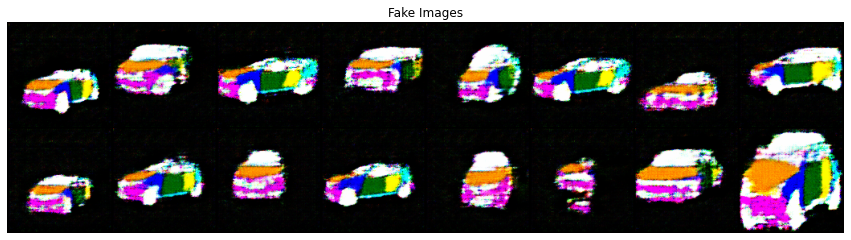

[561/1000][6/7]	Loss_D: 0.2956	Loss_G: 2.4615	D(x): 0.7959	D(G(z)): 0.0584 / 0.1128
[562/1000][6/7]	Loss_D: 0.1776	Loss_G: 2.9342	D(x): 0.9082	D(G(z)): 0.0749 / 0.0628
[563/1000][6/7]	Loss_D: 0.2025	Loss_G: 2.4552	D(x): 0.8716	D(G(z)): 0.0574 / 0.1181
[564/1000][6/7]	Loss_D: 0.1030	Loss_G: 3.8206	D(x): 0.9555	D(G(z)): 0.0542 / 0.0281
[565/1000][6/7]	Loss_D: 0.3131	Loss_G: 3.9707	D(x): 0.9755	D(G(z)): 0.2259 / 0.0232
[566/1000][6/7]	Loss_D: 0.1564	Loss_G: 2.8738	D(x): 0.9058	D(G(z)): 0.0535 / 0.0650
[567/1000][6/7]	Loss_D: 0.1400	Loss_G: 4.0379	D(x): 0.9525	D(G(z)): 0.0759 / 0.0324
[568/1000][6/7]	Loss_D: 0.2477	Loss_G: 3.9425	D(x): 0.9861	D(G(z)): 0.1918 / 0.0238
[569/1000][6/7]	Loss_D: 0.0747	Loss_G: 3.7921	D(x): 0.9677	D(G(z)): 0.0400 / 0.0329
[570/1000][6/7]	Loss_D: 0.1983	Loss_G: 2.6150	D(x): 0.8860	D(G(z)): 0.0709 / 0.0917
[571/1000][6/7]	Loss_D: 0.2072	Loss_G: 3.0462	D(x): 0.8678	D(G(z)): 0.0597 / 0.0606
[572/1000][6/7]	Loss_D: 0.1790	Loss_G: 2.1682	D(x): 0.8661	D(G(z)): 0.0302 /

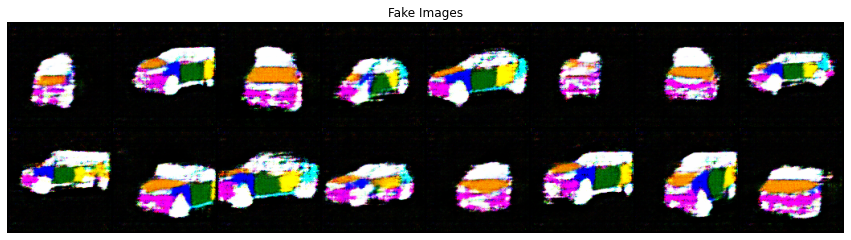

[581/1000][6/7]	Loss_D: 0.1727	Loss_G: 2.9529	D(x): 0.9129	D(G(z)): 0.0747 / 0.0684
[582/1000][6/7]	Loss_D: 0.1307	Loss_G: 2.2978	D(x): 0.9336	D(G(z)): 0.0583 / 0.1151
[583/1000][6/7]	Loss_D: 0.1698	Loss_G: 3.6193	D(x): 0.8521	D(G(z)): 0.0071 / 0.0399
[584/1000][6/7]	Loss_D: 0.0990	Loss_G: 3.8288	D(x): 0.9314	D(G(z)): 0.0265 / 0.0315
[585/1000][6/7]	Loss_D: 0.1290	Loss_G: 3.1668	D(x): 0.9106	D(G(z)): 0.0322 / 0.0565
[586/1000][6/7]	Loss_D: 0.4265	Loss_G: 5.5352	D(x): 0.9915	D(G(z)): 0.3024 / 0.0043
[587/1000][6/7]	Loss_D: 0.1516	Loss_G: 3.5029	D(x): 0.8989	D(G(z)): 0.0399 / 0.0527
[588/1000][6/7]	Loss_D: 0.0779	Loss_G: 4.5075	D(x): 0.9851	D(G(z)): 0.0597 / 0.0165
[589/1000][6/7]	Loss_D: 0.1582	Loss_G: 2.8317	D(x): 0.9145	D(G(z)): 0.0639 / 0.0735
[590/1000][6/7]	Loss_D: 0.2542	Loss_G: 3.8147	D(x): 0.9117	D(G(z)): 0.1421 / 0.0245
[591/1000][6/7]	Loss_D: 0.1185	Loss_G: 3.0390	D(x): 0.9123	D(G(z)): 0.0250 / 0.0602
[592/1000][6/7]	Loss_D: 0.0877	Loss_G: 4.0384	D(x): 0.9353	D(G(z)): 0.0199 /

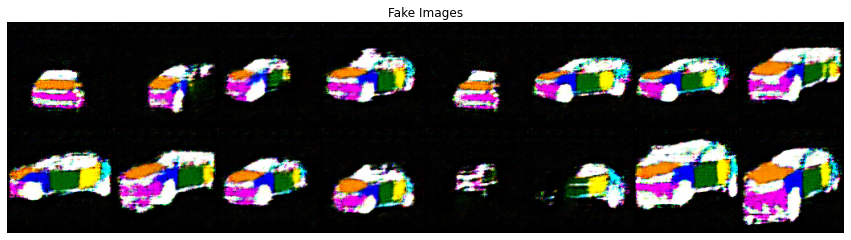

[601/1000][6/7]	Loss_D: 0.1664	Loss_G: 3.0852	D(x): 0.9213	D(G(z)): 0.0754 / 0.0603
[602/1000][6/7]	Loss_D: 0.1048	Loss_G: 3.0192	D(x): 0.9509	D(G(z)): 0.0513 / 0.0623
[603/1000][6/7]	Loss_D: 0.0944	Loss_G: 3.8903	D(x): 0.9677	D(G(z)): 0.0580 / 0.0279
[604/1000][6/7]	Loss_D: 0.2584	Loss_G: 4.3316	D(x): 0.9256	D(G(z)): 0.1514 / 0.0171
[605/1000][6/7]	Loss_D: 0.1760	Loss_G: 2.3610	D(x): 0.8736	D(G(z)): 0.0367 / 0.1218
[606/1000][6/7]	Loss_D: 0.1308	Loss_G: 4.3260	D(x): 0.9907	D(G(z)): 0.1080 / 0.0192
[607/1000][6/7]	Loss_D: 0.0867	Loss_G: 3.9224	D(x): 0.9376	D(G(z)): 0.0205 / 0.0312
[608/1000][6/7]	Loss_D: 0.1033	Loss_G: 3.3280	D(x): 0.9243	D(G(z)): 0.0228 / 0.0494
[609/1000][6/7]	Loss_D: 0.2305	Loss_G: 4.6807	D(x): 0.9788	D(G(z)): 0.1761 / 0.0128
[610/1000][6/7]	Loss_D: 0.0533	Loss_G: 4.5952	D(x): 0.9679	D(G(z)): 0.0200 / 0.0148
[611/1000][6/7]	Loss_D: 0.1245	Loss_G: 2.7654	D(x): 0.9076	D(G(z)): 0.0260 / 0.0931
[612/1000][6/7]	Loss_D: 0.1716	Loss_G: 2.9000	D(x): 0.9032	D(G(z)): 0.0617 /

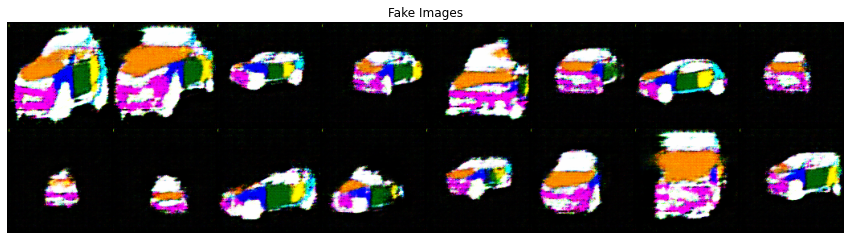

[621/1000][6/7]	Loss_D: 0.1682	Loss_G: 2.3755	D(x): 0.8738	D(G(z)): 0.0299 / 0.1407
[622/1000][6/7]	Loss_D: 0.7425	Loss_G: 4.3271	D(x): 0.9739	D(G(z)): 0.4756 / 0.0179
[623/1000][6/7]	Loss_D: 0.7371	Loss_G: 2.6093	D(x): 0.8239	D(G(z)): 0.3934 / 0.0771
[624/1000][6/7]	Loss_D: 0.1523	Loss_G: 3.3029	D(x): 0.9354	D(G(z)): 0.0796 / 0.0458
[625/1000][6/7]	Loss_D: 0.3799	Loss_G: 3.4399	D(x): 0.9754	D(G(z)): 0.2852 / 0.0381
[626/1000][6/7]	Loss_D: 0.1566	Loss_G: 3.3092	D(x): 0.9384	D(G(z)): 0.0854 / 0.0439
[627/1000][6/7]	Loss_D: 0.1268	Loss_G: 3.5133	D(x): 0.9240	D(G(z)): 0.0443 / 0.0420
[628/1000][6/7]	Loss_D: 0.1426	Loss_G: 2.9085	D(x): 0.9386	D(G(z)): 0.0743 / 0.0701
[629/1000][6/7]	Loss_D: 0.2101	Loss_G: 3.2361	D(x): 0.9348	D(G(z)): 0.1229 / 0.0520
[630/1000][6/7]	Loss_D: 0.1199	Loss_G: 3.4253	D(x): 0.9128	D(G(z)): 0.0261 / 0.0409
[631/1000][6/7]	Loss_D: 0.4416	Loss_G: 1.0691	D(x): 0.6698	D(G(z)): 0.0264 / 0.4272
[632/1000][6/7]	Loss_D: 0.1505	Loss_G: 3.6250	D(x): 0.9328	D(G(z)): 0.0755 /

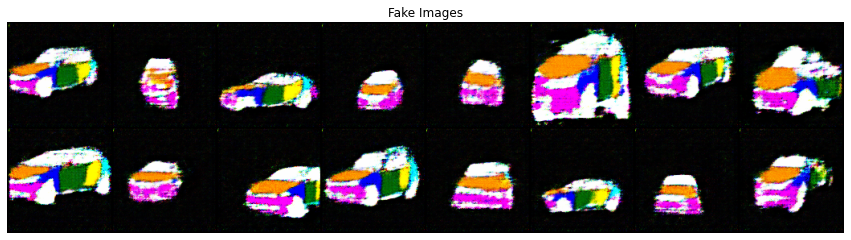

[641/1000][6/7]	Loss_D: 0.1924	Loss_G: 3.5005	D(x): 0.9856	D(G(z)): 0.1583 / 0.0352
[642/1000][6/7]	Loss_D: 0.1063	Loss_G: 3.0198	D(x): 0.9656	D(G(z)): 0.0664 / 0.0658
[643/1000][6/7]	Loss_D: 0.1081	Loss_G: 3.8259	D(x): 0.9117	D(G(z)): 0.0151 / 0.0285
[644/1000][6/7]	Loss_D: 0.1452	Loss_G: 2.7464	D(x): 0.8845	D(G(z)): 0.0195 / 0.0813
[645/1000][6/7]	Loss_D: 0.1523	Loss_G: 2.9869	D(x): 0.8717	D(G(z)): 0.0113 / 0.0741
[646/1000][6/7]	Loss_D: 0.2353	Loss_G: 3.4394	D(x): 0.9189	D(G(z)): 0.1156 / 0.0388
[647/1000][6/7]	Loss_D: 0.1620	Loss_G: 3.4474	D(x): 0.8809	D(G(z)): 0.0244 / 0.0468
[648/1000][6/7]	Loss_D: 0.1146	Loss_G: 3.3375	D(x): 0.9348	D(G(z)): 0.0445 / 0.0452
[649/1000][6/7]	Loss_D: 0.0721	Loss_G: 3.7351	D(x): 0.9530	D(G(z)): 0.0230 / 0.0313
[650/1000][6/7]	Loss_D: 0.0572	Loss_G: 4.2000	D(x): 0.9574	D(G(z)): 0.0133 / 0.0199
[651/1000][6/7]	Loss_D: 0.1037	Loss_G: 3.3558	D(x): 0.9309	D(G(z)): 0.0309 / 0.0540
[652/1000][6/7]	Loss_D: 0.1150	Loss_G: 4.5397	D(x): 0.9808	D(G(z)): 0.0874 /

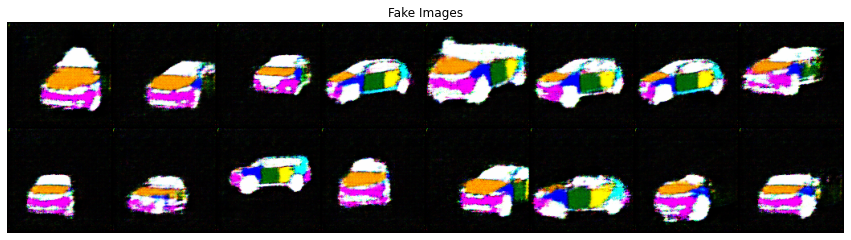

[661/1000][6/7]	Loss_D: 0.0889	Loss_G: 4.0670	D(x): 0.9244	D(G(z)): 0.0091 / 0.0286
[662/1000][6/7]	Loss_D: 0.2149	Loss_G: 6.0038	D(x): 0.9885	D(G(z)): 0.1653 / 0.0031
[663/1000][6/7]	Loss_D: 0.1185	Loss_G: 3.8212	D(x): 0.9175	D(G(z)): 0.0294 / 0.0328
[664/1000][6/7]	Loss_D: 0.1614	Loss_G: 3.5835	D(x): 0.8634	D(G(z)): 0.0075 / 0.0391
[665/1000][6/7]	Loss_D: 0.0708	Loss_G: 4.6914	D(x): 0.9428	D(G(z)): 0.0114 / 0.0175
[666/1000][6/7]	Loss_D: 0.1223	Loss_G: 2.6948	D(x): 0.9234	D(G(z)): 0.0408 / 0.0814
[667/1000][6/7]	Loss_D: 0.1291	Loss_G: 3.5795	D(x): 0.9403	D(G(z)): 0.0633 / 0.0349
[668/1000][6/7]	Loss_D: 0.0839	Loss_G: 3.6057	D(x): 0.9459	D(G(z)): 0.0270 / 0.0473
[669/1000][6/7]	Loss_D: 0.0573	Loss_G: 4.3471	D(x): 0.9695	D(G(z)): 0.0253 / 0.0201
[670/1000][6/7]	Loss_D: 0.0449	Loss_G: 4.2229	D(x): 0.9782	D(G(z)): 0.0224 / 0.0187
[671/1000][6/7]	Loss_D: 0.0918	Loss_G: 3.8216	D(x): 0.9440	D(G(z)): 0.0326 / 0.0334
[672/1000][6/7]	Loss_D: 0.1779	Loss_G: 1.8092	D(x): 0.8765	D(G(z)): 0.0396 /

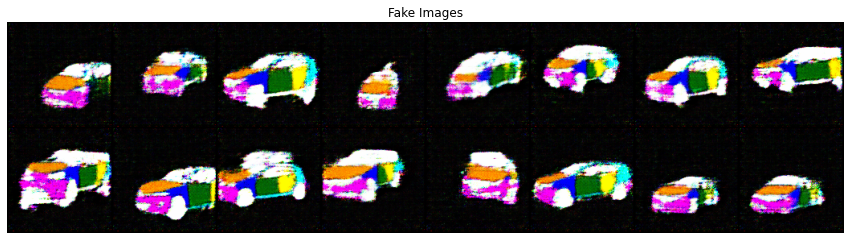

[681/1000][6/7]	Loss_D: 0.1676	Loss_G: 3.2721	D(x): 0.9298	D(G(z)): 0.0862 / 0.0548
[682/1000][6/7]	Loss_D: 0.0916	Loss_G: 3.7101	D(x): 0.9473	D(G(z)): 0.0345 / 0.0391
[683/1000][6/7]	Loss_D: 0.0827	Loss_G: 3.7148	D(x): 0.9573	D(G(z)): 0.0376 / 0.0324
[684/1000][6/7]	Loss_D: 0.1552	Loss_G: 2.9946	D(x): 0.8758	D(G(z)): 0.0206 / 0.0623
[685/1000][6/7]	Loss_D: 0.2576	Loss_G: 3.8293	D(x): 0.7982	D(G(z)): 0.0036 / 0.0322
[686/1000][6/7]	Loss_D: 0.2121	Loss_G: 2.8319	D(x): 0.9070	D(G(z)): 0.1025 / 0.0694
[687/1000][6/7]	Loss_D: 0.0542	Loss_G: 4.5702	D(x): 0.9619	D(G(z)): 0.0146 / 0.0134
[688/1000][6/7]	Loss_D: 0.1458	Loss_G: 2.3579	D(x): 0.9052	D(G(z)): 0.0425 / 0.1127
[689/1000][6/7]	Loss_D: 0.0895	Loss_G: 3.4547	D(x): 0.9449	D(G(z)): 0.0317 / 0.0404
[690/1000][6/7]	Loss_D: 0.0546	Loss_G: 3.9360	D(x): 0.9667	D(G(z)): 0.0202 / 0.0238
[691/1000][6/7]	Loss_D: 0.0544	Loss_G: 4.2368	D(x): 0.9692	D(G(z)): 0.0226 / 0.0203
[692/1000][6/7]	Loss_D: 0.0519	Loss_G: 4.3561	D(x): 0.9879	D(G(z)): 0.0383 /

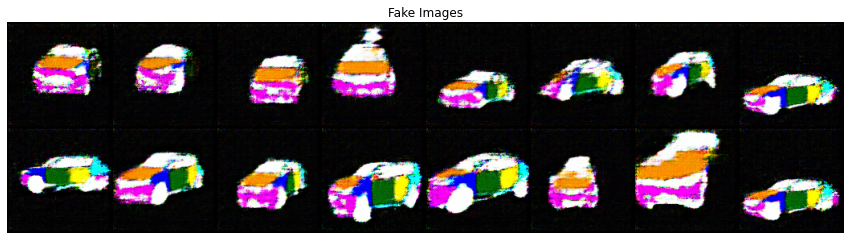

[701/1000][6/7]	Loss_D: 0.0382	Loss_G: 4.6637	D(x): 0.9746	D(G(z)): 0.0123 / 0.0122
[702/1000][6/7]	Loss_D: 0.0373	Loss_G: 4.7132	D(x): 0.9761	D(G(z)): 0.0130 / 0.0106
[703/1000][6/7]	Loss_D: 0.0830	Loss_G: 3.8613	D(x): 0.9756	D(G(z)): 0.0548 / 0.0294
[704/1000][6/7]	Loss_D: 0.0834	Loss_G: 4.3678	D(x): 0.9512	D(G(z)): 0.0307 / 0.0232
[705/1000][6/7]	Loss_D: 0.0652	Loss_G: 4.8797	D(x): 0.9852	D(G(z)): 0.0481 / 0.0117
[706/1000][6/7]	Loss_D: 0.0606	Loss_G: 4.1819	D(x): 0.9514	D(G(z)): 0.0101 / 0.0272
[707/1000][6/7]	Loss_D: 0.0458	Loss_G: 3.8896	D(x): 0.9881	D(G(z)): 0.0327 / 0.0238
[708/1000][6/7]	Loss_D: 0.0330	Loss_G: 5.0330	D(x): 0.9777	D(G(z)): 0.0102 / 0.0107
[709/1000][6/7]	Loss_D: 0.0481	Loss_G: 4.7110	D(x): 0.9638	D(G(z)): 0.0111 / 0.0136
[710/1000][6/7]	Loss_D: 0.0824	Loss_G: 3.7869	D(x): 0.9509	D(G(z)): 0.0307 / 0.0310
[711/1000][6/7]	Loss_D: 0.4145	Loss_G: 3.0278	D(x): 0.6767	D(G(z)): 0.0007 / 0.1356
[712/1000][6/7]	Loss_D: 0.0896	Loss_G: 4.0032	D(x): 0.9437	D(G(z)): 0.0301 /

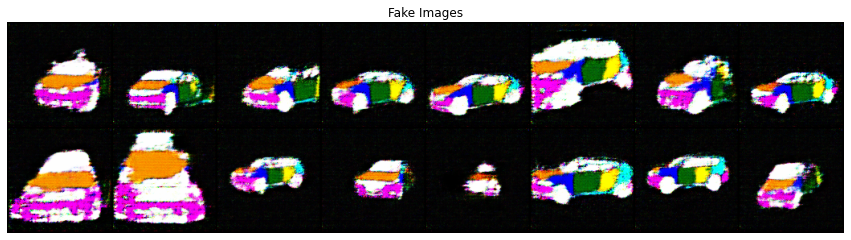

[721/1000][6/7]	Loss_D: 0.0556	Loss_G: 4.4514	D(x): 0.9800	D(G(z)): 0.0332 / 0.0167
[722/1000][6/7]	Loss_D: 0.0400	Loss_G: 4.1185	D(x): 0.9921	D(G(z)): 0.0314 / 0.0181
[723/1000][6/7]	Loss_D: 0.0557	Loss_G: 4.3727	D(x): 0.9648	D(G(z)): 0.0191 / 0.0204
[724/1000][6/7]	Loss_D: 0.0357	Loss_G: 4.7669	D(x): 0.9838	D(G(z)): 0.0190 / 0.0120
[725/1000][6/7]	Loss_D: 0.0304	Loss_G: 4.3869	D(x): 0.9800	D(G(z)): 0.0101 / 0.0148
[726/1000][6/7]	Loss_D: 0.1643	Loss_G: 2.8357	D(x): 0.8928	D(G(z)): 0.0431 / 0.0904
[727/1000][6/7]	Loss_D: 0.0610	Loss_G: 4.3970	D(x): 0.9787	D(G(z)): 0.0381 / 0.0163
[728/1000][6/7]	Loss_D: 0.0764	Loss_G: 3.7321	D(x): 0.9345	D(G(z)): 0.0078 / 0.0340
[729/1000][6/7]	Loss_D: 0.0497	Loss_G: 5.2368	D(x): 0.9575	D(G(z)): 0.0058 / 0.0082
[730/1000][6/7]	Loss_D: 0.0407	Loss_G: 5.0080	D(x): 0.9648	D(G(z)): 0.0047 / 0.0109
[731/1000][6/7]	Loss_D: 0.0445	Loss_G: 4.1480	D(x): 0.9718	D(G(z)): 0.0155 / 0.0223
[732/1000][6/7]	Loss_D: 0.0537	Loss_G: 4.5539	D(x): 0.9568	D(G(z)): 0.0089 /

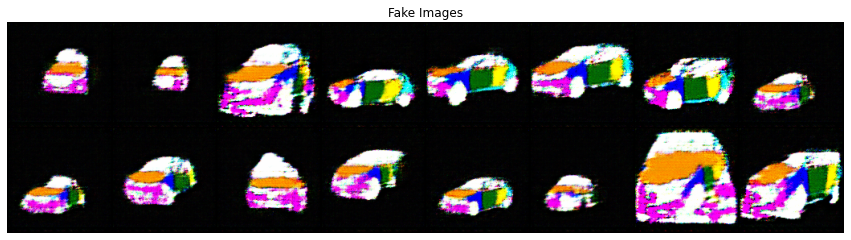

[741/1000][6/7]	Loss_D: 0.0532	Loss_G: 5.0249	D(x): 0.9897	D(G(z)): 0.0414 / 0.0095
[742/1000][6/7]	Loss_D: 0.0458	Loss_G: 3.9444	D(x): 0.9787	D(G(z)): 0.0237 / 0.0280
[743/1000][6/7]	Loss_D: 0.1095	Loss_G: 4.9598	D(x): 0.9770	D(G(z)): 0.0789 / 0.0096
[744/1000][6/7]	Loss_D: 0.0391	Loss_G: 4.7911	D(x): 0.9689	D(G(z)): 0.0073 / 0.0118
[745/1000][6/7]	Loss_D: 0.1733	Loss_G: 3.8640	D(x): 0.8561	D(G(z)): 0.0041 / 0.0278
[746/1000][6/7]	Loss_D: 0.0902	Loss_G: 4.6597	D(x): 0.9908	D(G(z)): 0.0766 / 0.0116
[747/1000][6/7]	Loss_D: 0.1748	Loss_G: 2.7954	D(x): 0.8469	D(G(z)): 0.0033 / 0.0810
[748/1000][6/7]	Loss_D: 2.3418	Loss_G: 0.3691	D(x): 0.1881	D(G(z)): 0.2698 / 0.7359
[749/1000][6/7]	Loss_D: 0.9022	Loss_G: 1.4700	D(x): 0.5412	D(G(z)): 0.1268 / 0.3359
[750/1000][6/7]	Loss_D: 0.9435	Loss_G: 3.5549	D(x): 0.7405	D(G(z)): 0.4368 / 0.0567
[751/1000][6/7]	Loss_D: 0.4649	Loss_G: 1.8437	D(x): 0.7303	D(G(z)): 0.0950 / 0.2176
[752/1000][6/7]	Loss_D: 0.3281	Loss_G: 2.6292	D(x): 0.8242	D(G(z)): 0.1106 /

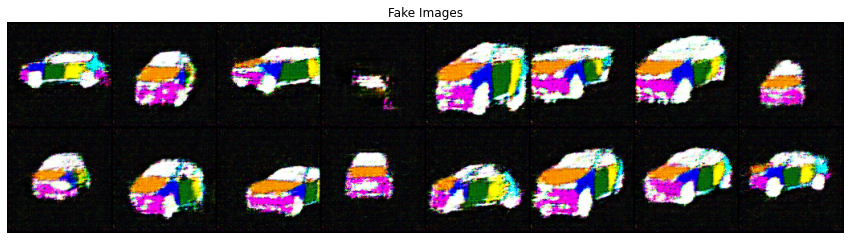

[761/1000][6/7]	Loss_D: 0.0747	Loss_G: 3.7461	D(x): 0.9533	D(G(z)): 0.0256 / 0.0359
[762/1000][6/7]	Loss_D: 0.0873	Loss_G: 3.9487	D(x): 0.9629	D(G(z)): 0.0474 / 0.0249
[763/1000][6/7]	Loss_D: 0.1853	Loss_G: 4.0876	D(x): 0.9553	D(G(z)): 0.1264 / 0.0206
[764/1000][6/7]	Loss_D: 0.0402	Loss_G: 4.2935	D(x): 0.9793	D(G(z)): 0.0190 / 0.0170
[765/1000][6/7]	Loss_D: 0.0824	Loss_G: 3.7044	D(x): 0.9490	D(G(z)): 0.0290 / 0.0294
[766/1000][6/7]	Loss_D: 0.0453	Loss_G: 4.0937	D(x): 0.9820	D(G(z)): 0.0264 / 0.0196
[767/1000][6/7]	Loss_D: 0.0450	Loss_G: 5.0263	D(x): 0.9616	D(G(z)): 0.0056 / 0.0078
[768/1000][6/7]	Loss_D: 0.0329	Loss_G: 5.1588	D(x): 0.9758	D(G(z)): 0.0083 / 0.0091
[769/1000][6/7]	Loss_D: 0.0692	Loss_G: 3.5608	D(x): 0.9785	D(G(z)): 0.0458 / 0.0346
[770/1000][6/7]	Loss_D: 0.1018	Loss_G: 3.2727	D(x): 0.9191	D(G(z)): 0.0155 / 0.0425
[771/1000][6/7]	Loss_D: 0.1400	Loss_G: 2.8796	D(x): 0.9056	D(G(z)): 0.0383 / 0.0693
[772/1000][6/7]	Loss_D: 0.0851	Loss_G: 3.7346	D(x): 0.9526	D(G(z)): 0.0351 /

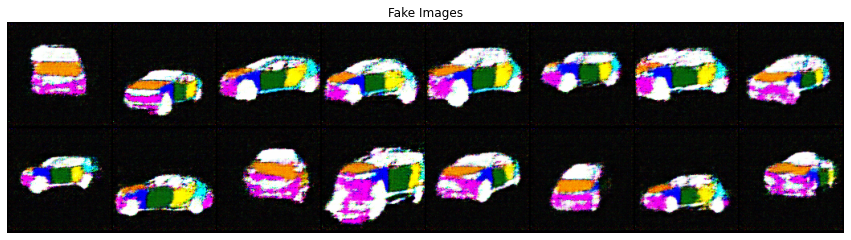

[781/1000][6/7]	Loss_D: 0.1163	Loss_G: 3.2164	D(x): 0.9221	D(G(z)): 0.0334 / 0.0540
[782/1000][6/7]	Loss_D: 0.0571	Loss_G: 3.8286	D(x): 0.9863	D(G(z)): 0.0416 / 0.0273
[783/1000][6/7]	Loss_D: 0.0924	Loss_G: 3.4639	D(x): 0.9269	D(G(z)): 0.0162 / 0.0395
[784/1000][6/7]	Loss_D: 0.0909	Loss_G: 4.7373	D(x): 0.9853	D(G(z)): 0.0706 / 0.0129
[785/1000][6/7]	Loss_D: 0.1069	Loss_G: 4.0109	D(x): 0.9460	D(G(z)): 0.0486 / 0.0251
[786/1000][6/7]	Loss_D: 0.0412	Loss_G: 4.2482	D(x): 0.9840	D(G(z)): 0.0246 / 0.0163
[787/1000][6/7]	Loss_D: 0.0641	Loss_G: 4.4023	D(x): 0.9534	D(G(z)): 0.0158 / 0.0223
[788/1000][6/7]	Loss_D: 0.0347	Loss_G: 4.1940	D(x): 0.9881	D(G(z)): 0.0221 / 0.0205
[789/1000][6/7]	Loss_D: 0.0621	Loss_G: 4.3401	D(x): 0.9953	D(G(z)): 0.0549 / 0.0154
[790/1000][6/7]	Loss_D: 0.0786	Loss_G: 4.9248	D(x): 0.9303	D(G(z)): 0.0044 / 0.0113
[791/1000][6/7]	Loss_D: 0.0690	Loss_G: 4.1922	D(x): 0.9404	D(G(z)): 0.0067 / 0.0205
[792/1000][6/7]	Loss_D: 0.0361	Loss_G: 4.6738	D(x): 0.9734	D(G(z)): 0.0089 /

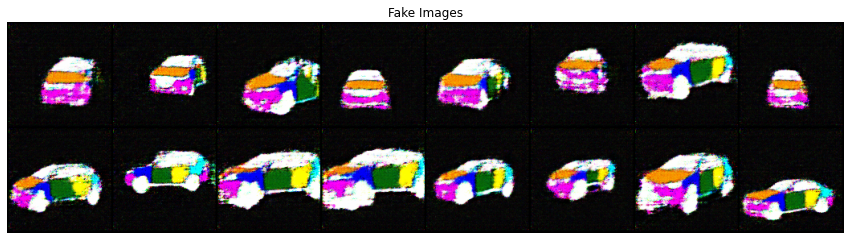

[801/1000][6/7]	Loss_D: 0.0514	Loss_G: 4.1562	D(x): 0.9705	D(G(z)): 0.0208 / 0.0190
[802/1000][6/7]	Loss_D: 0.0416	Loss_G: 4.1771	D(x): 0.9729	D(G(z)): 0.0138 / 0.0234
[803/1000][6/7]	Loss_D: 0.0254	Loss_G: 5.0859	D(x): 0.9814	D(G(z)): 0.0065 / 0.0081
[804/1000][6/7]	Loss_D: 0.0963	Loss_G: 4.4085	D(x): 0.9652	D(G(z)): 0.0578 / 0.0178
[805/1000][6/7]	Loss_D: 0.0393	Loss_G: 4.9262	D(x): 0.9658	D(G(z)): 0.0043 / 0.0095
[806/1000][6/7]	Loss_D: 0.3897	Loss_G: 0.2721	D(x): 0.7184	D(G(z)): 0.0202 / 0.7887
[807/1000][6/7]	Loss_D: 1.4051	Loss_G: 1.3106	D(x): 0.6959	D(G(z)): 0.4403 / 0.3586
[808/1000][6/7]	Loss_D: 0.6855	Loss_G: 1.4285	D(x): 0.6182	D(G(z)): 0.1031 / 0.2751
[809/1000][6/7]	Loss_D: 0.8617	Loss_G: 1.2049	D(x): 0.4772	D(G(z)): 0.0417 / 0.3218
[810/1000][6/7]	Loss_D: 0.1864	Loss_G: 3.4757	D(x): 0.9150	D(G(z)): 0.0891 / 0.0427
[811/1000][6/7]	Loss_D: 0.3879	Loss_G: 1.8132	D(x): 0.7233	D(G(z)): 0.0450 / 0.2182
[812/1000][6/7]	Loss_D: 0.1048	Loss_G: 3.5318	D(x): 0.9521	D(G(z)): 0.0534 /

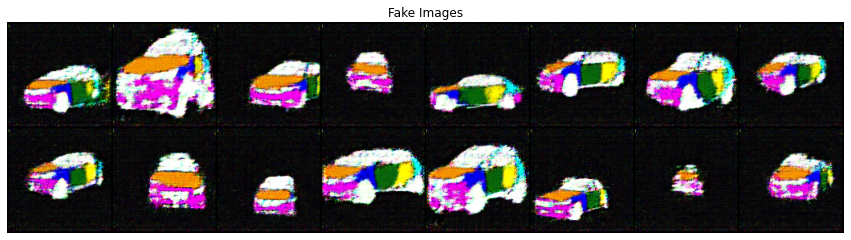

[821/1000][6/7]	Loss_D: 0.0522	Loss_G: 4.1915	D(x): 0.9819	D(G(z)): 0.0331 / 0.0194
[822/1000][6/7]	Loss_D: 0.0264	Loss_G: 4.9664	D(x): 0.9822	D(G(z)): 0.0084 / 0.0097
[823/1000][6/7]	Loss_D: 0.0547	Loss_G: 4.1072	D(x): 0.9726	D(G(z)): 0.0263 / 0.0231
[824/1000][6/7]	Loss_D: 0.0721	Loss_G: 4.2635	D(x): 0.9415	D(G(z)): 0.0111 / 0.0187
[825/1000][6/7]	Loss_D: 0.1904	Loss_G: 2.4560	D(x): 0.8470	D(G(z)): 0.0184 / 0.1147
[826/1000][6/7]	Loss_D: 0.0656	Loss_G: 4.0730	D(x): 0.9674	D(G(z)): 0.0306 / 0.0240
[827/1000][6/7]	Loss_D: 0.0313	Loss_G: 4.6850	D(x): 0.9808	D(G(z)): 0.0118 / 0.0115
[828/1000][6/7]	Loss_D: 0.1040	Loss_G: 3.3153	D(x): 0.9246	D(G(z)): 0.0236 / 0.0460
[829/1000][6/7]	Loss_D: 0.0689	Loss_G: 4.6274	D(x): 0.9390	D(G(z)): 0.0050 / 0.0148
[830/1000][6/7]	Loss_D: 0.0506	Loss_G: 4.3535	D(x): 0.9872	D(G(z)): 0.0362 / 0.0198
[831/1000][6/7]	Loss_D: 0.0358	Loss_G: 4.5651	D(x): 0.9758	D(G(z)): 0.0111 / 0.0145
[832/1000][6/7]	Loss_D: 0.0361	Loss_G: 4.8540	D(x): 0.9731	D(G(z)): 0.0086 /

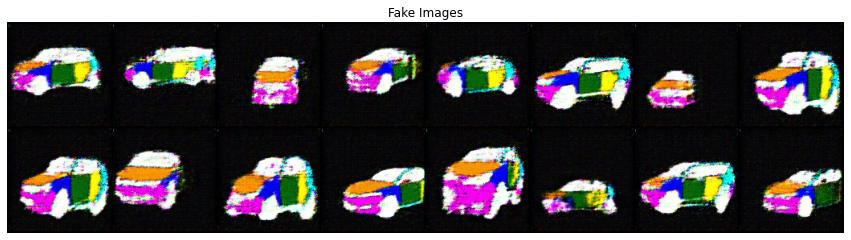

[841/1000][6/7]	Loss_D: 0.0532	Loss_G: 4.0280	D(x): 0.9833	D(G(z)): 0.0355 / 0.0192
[842/1000][6/7]	Loss_D: 0.0357	Loss_G: 4.5555	D(x): 0.9851	D(G(z)): 0.0202 / 0.0147
[843/1000][6/7]	Loss_D: 0.0481	Loss_G: 4.3761	D(x): 0.9648	D(G(z)): 0.0119 / 0.0179
[844/1000][6/7]	Loss_D: 0.0391	Loss_G: 4.8272	D(x): 0.9858	D(G(z)): 0.0241 / 0.0143
[845/1000][6/7]	Loss_D: 0.0397	Loss_G: 4.5417	D(x): 0.9773	D(G(z)): 0.0165 / 0.0150
[846/1000][6/7]	Loss_D: 0.0638	Loss_G: 4.2297	D(x): 0.9710	D(G(z)): 0.0331 / 0.0203
[847/1000][6/7]	Loss_D: 0.0633	Loss_G: 4.3626	D(x): 0.9742	D(G(z)): 0.0357 / 0.0177
[848/1000][6/7]	Loss_D: 0.0303	Loss_G: 4.8058	D(x): 0.9833	D(G(z)): 0.0132 / 0.0119
[849/1000][6/7]	Loss_D: 0.0491	Loss_G: 4.2135	D(x): 0.9828	D(G(z)): 0.0306 / 0.0196
[850/1000][6/7]	Loss_D: 0.0599	Loss_G: 4.7270	D(x): 0.9473	D(G(z)): 0.0054 / 0.0115
[851/1000][6/7]	Loss_D: 0.0279	Loss_G: 4.6191	D(x): 0.9832	D(G(z)): 0.0108 / 0.0154
[852/1000][6/7]	Loss_D: 0.0231	Loss_G: 6.4507	D(x): 0.9808	D(G(z)): 0.0037 /

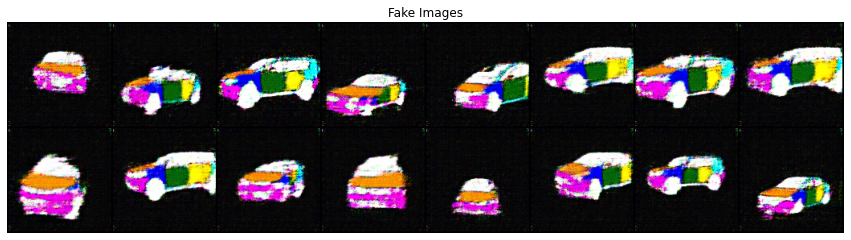

[861/1000][6/7]	Loss_D: 0.0258	Loss_G: 5.1453	D(x): 0.9899	D(G(z)): 0.0152 / 0.0081
[862/1000][6/7]	Loss_D: 0.0118	Loss_G: 5.7603	D(x): 0.9924	D(G(z)): 0.0041 / 0.0043
[863/1000][6/7]	Loss_D: 0.0217	Loss_G: 4.9689	D(x): 0.9880	D(G(z)): 0.0094 / 0.0088
[864/1000][6/7]	Loss_D: 0.0234	Loss_G: 5.7826	D(x): 0.9817	D(G(z)): 0.0047 / 0.0056
[865/1000][6/7]	Loss_D: 0.0422	Loss_G: 4.4383	D(x): 0.9644	D(G(z)): 0.0058 / 0.0150
[866/1000][6/7]	Loss_D: 0.0308	Loss_G: 4.9491	D(x): 0.9949	D(G(z)): 0.0250 / 0.0118
[867/1000][6/7]	Loss_D: 0.0285	Loss_G: 4.9405	D(x): 0.9861	D(G(z)): 0.0142 / 0.0118
[868/1000][6/7]	Loss_D: 0.0229	Loss_G: 4.8880	D(x): 0.9834	D(G(z)): 0.0060 / 0.0112
[869/1000][6/7]	Loss_D: 0.0263	Loss_G: 5.0378	D(x): 0.9828	D(G(z)): 0.0089 / 0.0081
[870/1000][6/7]	Loss_D: 0.0367	Loss_G: 4.6695	D(x): 0.9796	D(G(z)): 0.0157 / 0.0130
[871/1000][6/7]	Loss_D: 0.0487	Loss_G: 4.5678	D(x): 0.9590	D(G(z)): 0.0064 / 0.0150
[872/1000][6/7]	Loss_D: 0.0440	Loss_G: 4.2176	D(x): 0.9696	D(G(z)): 0.0128 /

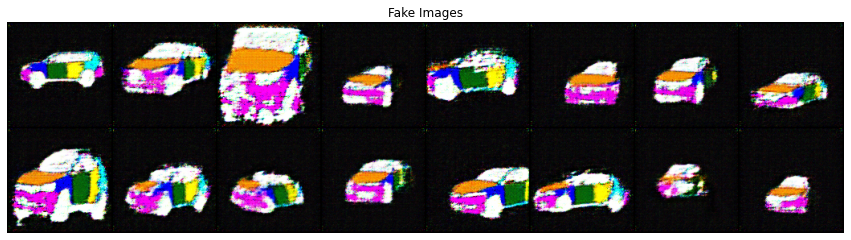

[881/1000][6/7]	Loss_D: 0.0776	Loss_G: 3.5048	D(x): 0.9348	D(G(z)): 0.0097 / 0.0426
[882/1000][6/7]	Loss_D: 0.0362	Loss_G: 5.1055	D(x): 0.9688	D(G(z)): 0.0043 / 0.0091
[883/1000][6/7]	Loss_D: 0.0367	Loss_G: 4.6791	D(x): 0.9952	D(G(z)): 0.0304 / 0.0158
[884/1000][6/7]	Loss_D: 0.0207	Loss_G: 5.1237	D(x): 0.9876	D(G(z)): 0.0082 / 0.0081
[885/1000][6/7]	Loss_D: 0.0164	Loss_G: 5.6416	D(x): 0.9891	D(G(z)): 0.0054 / 0.0051
[886/1000][6/7]	Loss_D: 0.0139	Loss_G: 5.2855	D(x): 0.9935	D(G(z)): 0.0073 / 0.0067
[887/1000][6/7]	Loss_D: 0.0535	Loss_G: 4.6366	D(x): 0.9848	D(G(z)): 0.0370 / 0.0126
[888/1000][6/7]	Loss_D: 0.0111	Loss_G: 5.3932	D(x): 0.9924	D(G(z)): 0.0034 / 0.0057
[889/1000][6/7]	Loss_D: 0.0347	Loss_G: 4.3394	D(x): 0.9929	D(G(z)): 0.0270 / 0.0154
[890/1000][6/7]	Loss_D: 0.0288	Loss_G: 5.0158	D(x): 0.9785	D(G(z)): 0.0070 / 0.0091
[891/1000][6/7]	Loss_D: 0.0142	Loss_G: 5.3641	D(x): 0.9943	D(G(z)): 0.0083 / 0.0064
[892/1000][6/7]	Loss_D: 0.0220	Loss_G: 5.2751	D(x): 0.9842	D(G(z)): 0.0060 /

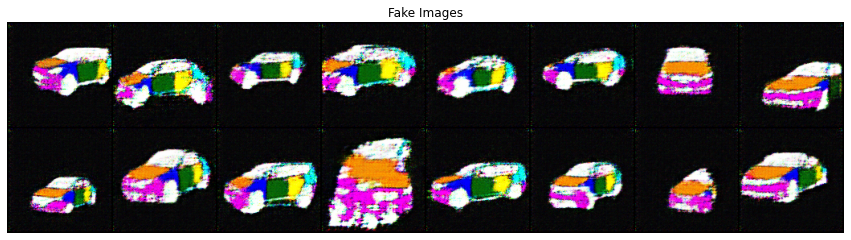

[901/1000][6/7]	Loss_D: 0.0333	Loss_G: 4.9821	D(x): 0.9716	D(G(z)): 0.0044 / 0.0109
[902/1000][6/7]	Loss_D: 0.0385	Loss_G: 4.7347	D(x): 0.9818	D(G(z)): 0.0196 / 0.0132
[903/1000][6/7]	Loss_D: 0.0473	Loss_G: 5.4510	D(x): 0.9940	D(G(z)): 0.0387 / 0.0066
[904/1000][6/7]	Loss_D: 0.1187	Loss_G: 5.6944	D(x): 0.9876	D(G(z)): 0.0964 / 0.0042
[905/1000][6/7]	Loss_D: 0.0464	Loss_G: 5.3814	D(x): 0.9872	D(G(z)): 0.0322 / 0.0072
[906/1000][6/7]	Loss_D: 0.0142	Loss_G: 5.5213	D(x): 0.9892	D(G(z)): 0.0033 / 0.0049
[907/1000][6/7]	Loss_D: 0.0272	Loss_G: 5.3330	D(x): 0.9794	D(G(z)): 0.0061 / 0.0085
[908/1000][6/7]	Loss_D: 0.0308	Loss_G: 4.9279	D(x): 0.9939	D(G(z)): 0.0242 / 0.0086
[909/1000][6/7]	Loss_D: 0.0300	Loss_G: 5.2153	D(x): 0.9933	D(G(z)): 0.0227 / 0.0090
[910/1000][6/7]	Loss_D: 0.0632	Loss_G: 3.4566	D(x): 0.9520	D(G(z)): 0.0121 / 0.0409
[911/1000][6/7]	Loss_D: 0.0139	Loss_G: 6.1614	D(x): 0.9912	D(G(z)): 0.0049 / 0.0037
[912/1000][6/7]	Loss_D: 0.0225	Loss_G: 5.7090	D(x): 0.9804	D(G(z)): 0.0026 /

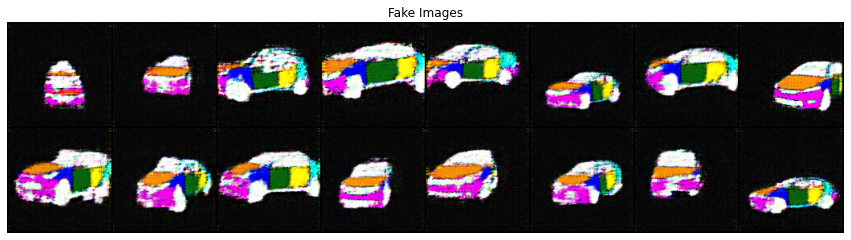

[921/1000][6/7]	Loss_D: 0.0329	Loss_G: 4.9645	D(x): 0.9762	D(G(z)): 0.0085 / 0.0098
[922/1000][6/7]	Loss_D: 0.0432	Loss_G: 4.6698	D(x): 0.9878	D(G(z)): 0.0297 / 0.0137
[923/1000][6/7]	Loss_D: 0.0209	Loss_G: 5.5249	D(x): 0.9913	D(G(z)): 0.0120 / 0.0066
[924/1000][6/7]	Loss_D: 0.0287	Loss_G: 5.0776	D(x): 0.9760	D(G(z)): 0.0043 / 0.0089
[925/1000][6/7]	Loss_D: 0.0122	Loss_G: 5.6771	D(x): 0.9936	D(G(z)): 0.0057 / 0.0060
[926/1000][6/7]	Loss_D: 0.0400	Loss_G: 6.0693	D(x): 0.9620	D(G(z)): 0.0011 / 0.0031
[927/1000][6/7]	Loss_D: 0.0197	Loss_G: 6.0899	D(x): 0.9953	D(G(z)): 0.0148 / 0.0031
[928/1000][6/7]	Loss_D: 0.0126	Loss_G: 6.1043	D(x): 0.9930	D(G(z)): 0.0056 / 0.0043
[929/1000][6/7]	Loss_D: 0.0257	Loss_G: 7.0962	D(x): 0.9754	D(G(z)): 0.0007 / 0.0017
[930/1000][6/7]	Loss_D: 0.1007	Loss_G: 3.0809	D(x): 0.9246	D(G(z)): 0.0084 / 0.0882
[931/1000][6/7]	Loss_D: 0.0578	Loss_G: 6.1265	D(x): 0.9927	D(G(z)): 0.0470 / 0.0034
[932/1000][6/7]	Loss_D: 0.1331	Loss_G: 6.7357	D(x): 0.9838	D(G(z)): 0.1003 /

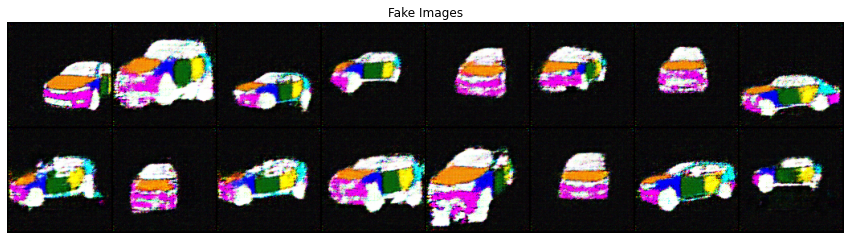

[941/1000][6/7]	Loss_D: 0.0571	Loss_G: 4.4680	D(x): 0.9771	D(G(z)): 0.0329 / 0.0165
[942/1000][6/7]	Loss_D: 0.0168	Loss_G: 5.8720	D(x): 0.9874	D(G(z)): 0.0041 / 0.0048
[943/1000][6/7]	Loss_D: 0.0155	Loss_G: 5.4029	D(x): 0.9892	D(G(z)): 0.0045 / 0.0064
[944/1000][6/7]	Loss_D: 0.0209	Loss_G: 5.6528	D(x): 0.9846	D(G(z)): 0.0053 / 0.0060
[945/1000][6/7]	Loss_D: 0.0183	Loss_G: 5.2687	D(x): 0.9967	D(G(z)): 0.0148 / 0.0082
[946/1000][6/7]	Loss_D: 0.0204	Loss_G: 5.6557	D(x): 0.9916	D(G(z)): 0.0118 / 0.0046
[947/1000][6/7]	Loss_D: 0.0254	Loss_G: 5.3285	D(x): 0.9785	D(G(z)): 0.0036 / 0.0084
[948/1000][6/7]	Loss_D: 0.0588	Loss_G: 4.9773	D(x): 0.9471	D(G(z)): 0.0023 / 0.0099
[949/1000][6/7]	Loss_D: 0.0712	Loss_G: 3.9900	D(x): 0.9379	D(G(z)): 0.0052 / 0.0304
[950/1000][6/7]	Loss_D: 0.0279	Loss_G: 4.5156	D(x): 0.9817	D(G(z)): 0.0092 / 0.0137
[951/1000][6/7]	Loss_D: 0.0151	Loss_G: 5.1799	D(x): 0.9942	D(G(z)): 0.0093 / 0.0074
[952/1000][6/7]	Loss_D: 0.0304	Loss_G: 5.4247	D(x): 0.9815	D(G(z)): 0.0115 /

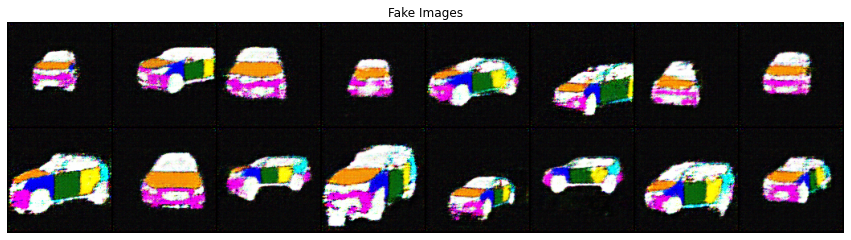

[961/1000][6/7]	Loss_D: 0.0822	Loss_G: 5.3378	D(x): 0.9256	D(G(z)): 0.0002 / 0.0109
[962/1000][6/7]	Loss_D: 0.0303	Loss_G: 4.8146	D(x): 0.9742	D(G(z)): 0.0037 / 0.0120
[963/1000][6/7]	Loss_D: 0.0181	Loss_G: 5.8222	D(x): 0.9941	D(G(z)): 0.0120 / 0.0052
[964/1000][6/7]	Loss_D: 0.0099	Loss_G: 5.9334	D(x): 0.9932	D(G(z)): 0.0031 / 0.0030
[965/1000][6/7]	Loss_D: 0.0048	Loss_G: 6.4786	D(x): 0.9976	D(G(z)): 0.0024 / 0.0021
[966/1000][6/7]	Loss_D: 0.0469	Loss_G: 4.2438	D(x): 0.9778	D(G(z)): 0.0237 / 0.0196
[967/1000][6/7]	Loss_D: 0.0243	Loss_G: 5.0275	D(x): 0.9848	D(G(z)): 0.0089 / 0.0088
[968/1000][6/7]	Loss_D: 0.0187	Loss_G: 4.9434	D(x): 0.9972	D(G(z)): 0.0157 / 0.0088
[969/1000][6/7]	Loss_D: 0.0270	Loss_G: 5.3213	D(x): 0.9969	D(G(z)): 0.0235 / 0.0063
[970/1000][6/7]	Loss_D: 0.0282	Loss_G: 5.1308	D(x): 0.9775	D(G(z)): 0.0053 / 0.0092
[971/1000][6/7]	Loss_D: 0.0374	Loss_G: 5.7574	D(x): 0.9942	D(G(z)): 0.0301 / 0.0039
[972/1000][6/7]	Loss_D: 0.0103	Loss_G: 7.1480	D(x): 0.9912	D(G(z)): 0.0014 /

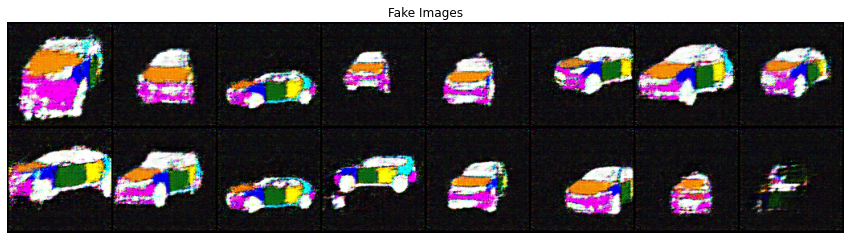

[981/1000][6/7]	Loss_D: 0.2110	Loss_G: 2.8238	D(x): 0.8502	D(G(z)): 0.0378 / 0.0787
[982/1000][6/7]	Loss_D: 0.0986	Loss_G: 4.4717	D(x): 0.9424	D(G(z)): 0.0366 / 0.0173
[983/1000][6/7]	Loss_D: 0.1068	Loss_G: 2.9992	D(x): 0.9717	D(G(z)): 0.0737 / 0.0544
[984/1000][6/7]	Loss_D: 0.0657	Loss_G: 4.5302	D(x): 0.9468	D(G(z)): 0.0098 / 0.0189
[985/1000][6/7]	Loss_D: 0.2454	Loss_G: 2.5562	D(x): 0.8049	D(G(z)): 0.0165 / 0.1020
[986/1000][6/7]	Loss_D: 0.1477	Loss_G: 4.4447	D(x): 0.9597	D(G(z)): 0.0949 / 0.0138
[987/1000][6/7]	Loss_D: 0.0756	Loss_G: 3.7760	D(x): 0.9517	D(G(z)): 0.0250 / 0.0285
[988/1000][6/7]	Loss_D: 0.0471	Loss_G: 4.1654	D(x): 0.9684	D(G(z)): 0.0146 / 0.0200
[989/1000][6/7]	Loss_D: 0.0519	Loss_G: 4.3943	D(x): 0.9608	D(G(z)): 0.0117 / 0.0162
[990/1000][6/7]	Loss_D: 0.0353	Loss_G: 4.3702	D(x): 0.9928	D(G(z)): 0.0274 / 0.0181
[991/1000][6/7]	Loss_D: 0.0533	Loss_G: 4.2948	D(x): 0.9868	D(G(z)): 0.0386 / 0.0174
[992/1000][6/7]	Loss_D: 0.0434	Loss_G: 4.4630	D(x): 0.9896	D(G(z)): 0.0322 /

In [30]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
fid_s=[]
max=1000
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    #for data,_ in dataloader:
    for i, data in enumerate(dataloader, 0):    

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

    if epoch % 1 == 0:
        print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                % (epoch, num_epochs, i, len(dataloader),
                  errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        G_losses.append( errG.item())
        D_losses.append(errD.item())
        fakes = fake_pre_process(fake)
        fid_new = []
        fakes = netG(fixed_noise).detach().cpu()
        fakes = fake_pre_process(fakes)
        fid = calculate_fid(model,fakes)
        fid_new.append(fid)
        fid = sum(fid_new)/len(fid_new) 
        fid_s.append(fid)  
        if fid<max:
            max = fid
            torch.save(netG.state_dict(), model_path+'model_1or_bs4_'+str(round(max,2))+'.pth')             

    if epoch % 20 ==0:

        # Check how the generator is doing by saving G's output on fixed_noise
        fake_imgs = vutils.make_grid(fake.detach().cpu(), padding=2, normalize=True)
        # Plot the real images
        plt.figure(figsize=(15,15))
        plt.axis("off")
        plt.title("Fake Images")
        plt.imshow(np.transpose(fake_imgs,(1,2,0)))
        plt.show()

            #img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1
    

                 

 
    

  






      

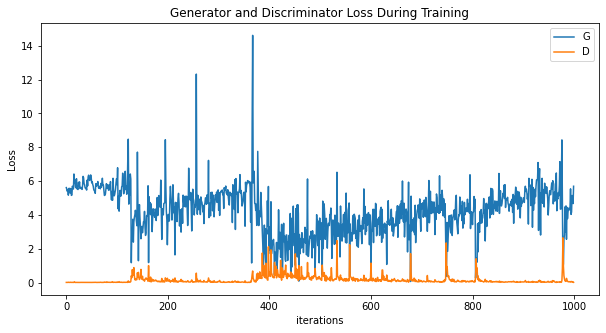

In [31]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

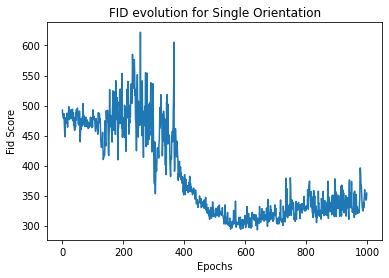

In [33]:
plt.plot(fid_s)
plt.xlabel('Epochs')
plt.ylabel('Fid Score')
plt.title('FID evolution for Single Orientation')
plt.savefig('fid.png')